In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import os
os.chdir('/content/drive/MyDrive/optiver_real_vol')

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

!pip install optuna
!pip install lightgbm \
  --config-settings=cmake.define.USE_GPU=ON \
  --config-settings=cmake.define.OpenCL_INCLUDE_DIR="/usr/local/cuda/include/" \
  --config-settings=cmake.define.OpenCL_LIBRARY="/usr/local/cuda/lib64/libOpenCL.so"
!mkdir -p /etc/OpenCL/vendors && echo "libnvidia-opencl.so.1" > /etc/OpenCL/vendors/nvidia.icd

Mounted at /content/drive
Mon Jan 22 07:13:43 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   32C    P0              47W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------

In [ ]:
import pickle
from datetime import datetime
import os
import gc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
import seaborn as sns
import lightgbm as lgb
from sklearn.model_selection import RepeatedKFold, cross_val_score, TimeSeriesSplit

import statsmodels.api as sm

from statsmodels.genmod.generalized_linear_model import GLM
import scipy.stats as stats

import warnings
#warnings.filterwarnings("ignore")
from sklearn.metrics import confusion_matrix
#from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay


from sklearn.utils import class_weight
import optuna
from optuna.trial import TrialState
from optuna.integration import LightGBMPruningCallback

from mlxtend.evaluate import bias_variance_decomp

In [ ]:
## get labels of features and target

os.chdir('/content/drive/MyDrive/optiver_real_vol/liquidity_features')


with open('int32_feat_labels.pkl', 'rb') as fp:
    int32_feat_labels = pickle.load(fp)
with open('int64_feat_labels.pkl', 'rb') as fp:
    int64_feat_labels = pickle.load(fp)

with open('float32_feat_labels.pkl', 'rb') as fp:
    float32_feat_labels = pickle.load(fp)
with open('float64_feat_labels.pkl', 'rb') as fp:
    float64_feat_labels = pickle.load(fp)

with open('target_labels.pkl', 'rb') as fp:
    target_labels = pickle.load(fp)



os.chdir('/content/drive/MyDrive/optiver_real_vol/liquidity_features')
with open('train_feat_df_reordered.pkl', 'rb') as fp:
    train_feat_df_reordered = pickle.load(fp)

df1 = train_feat_df_reordered.copy()
del train_feat_df_reordered

In [ ]:
#### hand picked features for training

hand_picked_cols = [
    "time_id",
    "stock_id",
    "log_liq2_ret__wap_eqi_price1_ret_vol",
    "exp_log_liq1_ret__wap_eqi_price1_ret_vol",
    "wap1_log_price_ret_per_liq2_vol",
    "wap1_log_price_ret_per_spread_sqr_vol",
    "wap1_log_price_ret_neg_log_liq_ret_sqr_vol",
    "wap1_log_price_ret_pos_log_liq_ret_sqr_vol",
    "wap1_log_price_ret_posneg_log_liq_ret_sqr_vol",
    "soft_stock_mean_tvpl2_liqf",
    "lsvol",
    "liqvol1",
    "trade_count",
    "root_book_delta_count",
    "tvpl2",
    "log_wap1_log_price_ret_vol",
    "log_first_10_min_vol_stnd",
    "log_1e3_trade_price_real_vol_stnd",
    "log1p_trade_order_count_std_stnd",
    "log1p_trade_order_count_mean_stnd",
    "log_target_vol_corr_32_clusters_stnd",
    "log_target_vol_sum_stats_16_clusters_stnd",
    "max_bid_price1",
    "max_ask_price1",
    "log_max_bid_size1_stnd",
    "log_1e3_range_bid_price1_stnd",
    "log1p_range_ask_size1_stnd",
    "log1p_sad_ask_size1_stnd",
    "log_1e2_sad_bid_price1_stnd",
    "exp_bs_as_corr1_stnd",
    "bs_ap_corr1",
    "max_price1",
    "log_max_size1_stnd",
    "log1p_range_order_count1_stnd",
    "log_1e3_sad_price1_stnd",
    "log1p_sad_size1_stnd",
    "size_order_count_corr1",
    "log_book_ewma_vol_stnd",
    "log1p_trade_ewma_vol_stnd",
    "max_bid_price2",
    "max_ask_price2",
    "log_max_bid_size2_stnd",
    "log_1e3_range_ask_price2_stnd",
    "log_range_ask_size2_stnd",
    "log_1e3_sad_bid_price2_stnd",
    "bs_bp_corr2",
    "bs_ap_corr2",
    "as_ap_corr2",
    "sum_stats_4_clusters_labels",
    "sum_stats_10_clusters_labels",
    "sum_stats_16_clusters_labels",
    "sum_stats_30_clusters_labels",
    "pear_corr_32_clusters_labels",
    "pear_corr_4_clusters_labels",
    "pear_corr_49_clusters_labels",
    "pear_corr_90_clusters_labels",
    "exp_root_trade_count_var_stnd",
    "seq_id",
    "per9_id",
    "per45_id",
    "per189_id",
    "target",
]


In [ ]:
# prompt: given a dataframe, df create lists of columns that belong to different datatypes

df2 = df1[hand_picked_cols]

obj_feat_labels = [col for col, dtype in df2.dtypes.items() if dtype == 'object']
int16_feat_labels = [col for col, dtype in df2.dtypes.items() if dtype == 'int16']
int32_feat_labels = [col for col, dtype in df2.dtypes.items() if dtype == 'int32']
int64_feat_labels = [col for col, dtype in df2.dtypes.items() if dtype == 'int64']
float32_feat_labels = [col for col, dtype in df2.dtypes.items() if dtype == 'float32']
float64_feat_labels = [col for col, dtype in df2.dtypes.items() if dtype == 'float64']
float64_feat_labels.remove('target')

df2[obj_feat_labels] = df2[obj_feat_labels].astype('category')
df2[int16_feat_labels] = df2[int16_feat_labels].astype('category')
df2[int32_feat_labels] = df2[int32_feat_labels].astype('category')
df2[int64_feat_labels] = df2[int64_feat_labels].astype('category')

cat_feat_labels = obj_feat_labels+int16_feat_labels +int32_feat_labels+ int64_feat_labels

<ipython-input-5-33d94d022f30>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2[obj_feat_labels] = df2[obj_feat_labels].astype('category')
<ipython-input-5-33d94d022f30>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2[int16_feat_labels] = df2[int16_feat_labels].astype('category')
<ipython-input-5-33d94d022f30>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation

##### Temporarily add sequence_id within each stock and the periodic information here

In [ ]:
# #### take reordered train_feat_df and include monotonically increasing sequence id, daily period, ordinal feature, weekly period ordinal feature and monthly period ordinal feature

# def my_seq_fill(x):
#   return np.tile(range(3830),1 )[:len(x)]

# def my_per9_fill(x):
#   return np.tile(range(9),426 )[:len(x)]

# def my_per45_fill(x):
#   return np.tile(range(45),86 )[:len(x)]

# def my_per189_fill(x):
#   return np.tile(range(189),21 )[:len(x)]

# import numpy as np
# x = pd.DataFrame({ 'stock_id': df['stock_id'].values  })

# seq_id =x.groupby('stock_id').apply(lambda x:my_seq_fill(x))
# seq_id = pd.DataFrame(seq_id).explode(0)
# seq_id

# per9_id =x.groupby('stock_id').apply(lambda x:my_per9_fill(x))
# per9_id = pd.DataFrame(per9_id).explode(0)
# per9_id

# per45_id =x.groupby('stock_id').apply(lambda x:my_per45_fill(x))
# per45_id = pd.DataFrame(per45_id).explode(0)
# per45_id

# per189_id =x.groupby('stock_id').apply(lambda x:my_per189_fill(x))
# per189_id = pd.DataFrame(per189_id).explode(0)
# per189_id

# df['seq_id'] = seq_id[0].values
# df['per9_id'] = per9_id[0].values
# df['per45_id'] = per45_id[0].values
# df['per189_id'] = per189_id[0].values
# df

# pickle.dump( df ,open('train_feat_df_reordered.pkl','wb') )

In [ ]:
# #### remove one of redundant columns, wap1_log_price_ret_vol and log_wap1_log_price_ret_vol

# df.drop(columns=['wap1_log_price_ret_vol'], inplace=True)
# pickle.dump( df ,open('train_feat_df_reordered.pkl','wb') )

# train_feat_df.drop(columns=['wap1_log_price_ret_vol'], inplace=True)
# pickle.dump( train_feat_df ,open('train_feat_df.pkl','wb') )

In [ ]:
class train_validate_n_test(object):

    def __init__(self,df) -> None:

        self.time_id_order = df.loc[:3829,'time_id'].values # select ordered unique time_ids
        self.train_time_id_ind = int(len(self.time_id_order)*0.7)
        self.n_folds = 10
        folds = TimeSeriesSplit(n_splits=self.n_folds,)# max_train_size=None, gap=10)
        self.splits = folds.split( range( self.train_time_id_ind ) ) # split 70% train time_ids into n_fold splits

        test_time_ids = self.time_id_order[self.train_time_id_ind:]
        self.test_df = df[df['time_id'].isin(test_time_ids)]
        self.df = df

        feature_importances = pd.DataFrame()
        self.feat_cols_list = cat_feat_labels+float32_feat_labels+float64_feat_labels # int32_feat_labels+int64_feat_labels+float32_feat_labels+float64_feat_labels
        feature_importances['feature'] = self.feat_cols_list


    #### RMSPE cost function
    def rmspe(self,y_true, y_pred):
        return np.sqrt(np.mean(np.square((y_true - y_pred) / y_true)))


    def lgbm_RMSPE(self,preds, train_data):
        labels = train_data.get_label()
        return 'RMSPE', round(self.rmspe(y_true = labels, y_pred = preds),5), False


    def nancorr(self,a, b):
        v = np.isfinite(a)*np.isfinite(b) > 0
        return np.corrcoef(a[v], b[v])[0,1]


    def lgbm_train_validate(self,params_lgbm,n_rounds,trial):
        rmspe_val_score = []
        models= []
        test_y_preds = np.zeros(len(self.test_df))

        for fold_n, (train_index, valid_index) in enumerate(self.splits):
            print('Fold:',fold_n+1)
            # print('train_index',train_index)
            # print('valid_index',valid_index)
            train_time_ids = self.time_id_order[train_index]
            val_time_ids = self.time_id_order[valid_index]
            train_df = self.df[self.df['time_id'].isin(train_time_ids)]
            val_df = self.df[self.df['time_id'].isin(val_time_ids)]

            X_train = train_df[self.feat_cols_list]
            y_train = train_df['target']
            X_valid = val_df[self.feat_cols_list]
            y_val = val_df['target']

            v1tr = np.exp(X_train['log_wap1_log_price_ret_vol'])
            v1v = np.exp(  X_valid['log_wap1_log_price_ret_vol'])
            v1ts = np.exp( self.test_df['log_wap1_log_price_ret_vol'])

            w_train = y_train **-2 * v1tr**2

            w_val = y_val **-2 * v1v**2

            dtrain = lgb.Dataset(X_train, label=y_train/v1tr, categorical_feature=  cat_feat_labels, weight = w_train )  # int64_feat_labels + int32_feat_labels+int16_feat_labels, weight=w_train)
            dvalid = lgb.Dataset(X_valid,   label=  y_val/v1v,   categorical_feature= cat_feat_labels, weight=w_val  )  #int64_feat_labels + int32_feat_labels+int16_feat_labels, weight=w_val  )


            print('model')
            reg = lgb.train(params_lgbm, dtrain, n_rounds, valid_sets = [dtrain, dvalid],valid_names=['train','valid'], feval=self.lgbm_RMSPE,
                    #   verbose_eval= 250,
                    #early_stopping_rounds=50,)
                      callbacks=[lgb.early_stopping(stopping_rounds=50), lgb.log_evaluation(period=50), ])# LightGBMPruningCallback(trial, "RMSPE","valid"  )])
            models.append(reg)


            p = reg.predict(X_valid)*v1v
            val_score =  np.mean( ((p-y_val)/y_val)**2 )**0.5

            # full_score += y_val.shape[0]*score**2

            print(f'fold: {fold_n}, val rmspe score is {val_score}')
            print('corr(p/v1v, y_val/v1v)',self.nancorr(       p/v1v ,        y_val/v1v ))
            print('log(corr( ))',self.nancorr(np.log(p/v1v), np.log(y_val/v1v)))
            print('corr(p, y_val)',self.nancorr(p, y_val))
            print('log(corr( ))',self.nancorr(np.log(p), np.log(y_val)))

            test_pred = reg.predict(self.test_df[self.feat_cols_list] )*v1ts
            test_y_preds += test_pred/self.n_folds

            rmspe_val_score.append(val_score)

            #del X_train, X_valid, y_train, y_val,train_df,val_df,dtrain,dvalid, v1tr, v1v, v1ts


        importances = pd.DataFrame({'Feature': reg.feature_name(),
                                    'Importance': sum( [model.feature_importance(importance_type='gain') for model in models] )})

        importances2 = importances.nlargest(40,'Importance', keep='first').sort_values(by='Importance', ascending=True)
        importances2[['Importance', 'Feature']].plot(kind = 'barh', x = 'Feature', figsize = (8,6), color = 'blue', fontsize=11);plt.ylabel('Feature', fontsize=12)

        mean_rmspe_val_score = np.mean(rmspe_val_score)
        print(f'mean rmspe val score over {self.n_folds} splits is',mean_rmspe_val_score)
        print(f'mean rmspe test score: ',  np.mean( ((test_y_preds-self.test_df['target'])/self.test_df['target'])**2 )**0.5  )

        del self.df, X_train, X_valid, y_train, y_val,train_df,val_df,dtrain,dvalid, v1tr, v1v, v1ts
        gc.collect()
        return mean_rmspe_val_score




    def evaluate_predictions(self,final_reg,test_pred, y_test,train_pred,y_train):

        v1ts = np.exp( self.test_df['log_wap1_log_price_ret_vol'])
        print('corr(test_pred/v1ts, y_test/v1ts)',self.nancorr(       test_pred/v1ts ,        self.test_df['target']/v1ts ))
        print('log(corr( ))',self.nancorr(np.log(test_pred/v1ts), np.log(self.test_df['target']/v1ts)))
        print('corr(test_pred, y_test)',self.nancorr(test_pred, self.test_df['target']))
        print('log(corr( ))',self.nancorr(np.log(test_pred), np.log(self.test_df['target'])))
        print(f'RMSPE train score: ',  np.mean( ((train_pred-y_train)/y_train)**2 )**0.5  )
        print(f'RMSPE test score: ',  np.mean( ((test_pred-self.test_df['target'])/self.test_df['target'])**2 )**0.5  )

        print('####################################### PREDICTION #################################################')

        y_true = y_test
        y_pred = test_pred
        residuals = y_true - y_pred

        ## plot of True Real. Vol. AND Pred Real. Vol.
        fig = go.Figure()
        fig.add_trace(go.Scatter(x=list(range(1, len(y_train) + 1)), y=y_train, mode='markers', name='True train Real. Vol. ', marker=dict(color='blue')))
        fig.add_trace(go.Scatter(x=list(range(1, len(train_pred) + 1)), y=train_pred, mode='markers', name='Pred train Real. Vol.', marker=dict(color='red')))
        fig.update_layout(title='True train Real. Vol. and. Pred train Real. Vol.',
                          xaxis_title='Sample Index',
                          yaxis_title='Values',
                          legend=dict(x=0.7, y=0.95))
        fig.show()


        ## plot of True Real. Vol. AND Pred Real. Vol.
        fig = go.Figure()
        fig.add_trace(go.Scatter(x=list(range(1, len(y_true) + 1)), y=y_true, mode='markers', name='True test Real. Vol. ', marker=dict(color='blue')))
        fig.add_trace(go.Scatter(x=list(range(1, len(y_pred) + 1)), y=y_pred, mode='markers', name='Pred test Real. Vol.', marker=dict(color='red')))
        fig.update_layout(title='True test Real. Vol. and. Pred test Real. Vol.',
                          xaxis_title='Sample Index',
                          yaxis_title='Values',
                          legend=dict(x=0.7, y=0.95))
        fig.show()

        ## scatter plot of True Real. Vol. vs. Pred Real. Vol.
        fig = px.scatter(x=y_true, y=y_pred, labels={'x': 'True test Values', 'y': 'Predicted test Values'})
        fig.add_trace(go.Scatter(x=y_true, y=y_true, mode='lines', line=dict(color='red', dash='dash'), name='Identity Line'))
        fig.update_layout(title='Scatter Plot of True vs Predicted Values on test set')
        fig.show()


        ## Residuals vs. Fitted Values Plot:
        fig = px.scatter(x=y_pred, y=residuals, labels={'x': 'Fitted test Values', 'y': 'Residuals'})
        fig.add_shape(type='line', line=dict(color='red', dash='dash'), x0=min(y_pred), x1=max(y_pred), y0=0, y1=0)
        fig.update_layout(title='Residuals vs. Fitted Values Plot on test set')
        fig.show()

        ## Normal Q-Q Plot:
        sm.qqplot(residuals, line='q')

        ## Residuals Distribution Histogram:
        fig = ff.create_distplot([residuals], group_labels=['Residuals'], colors=['blue'])
        fig.update_layout(title='Distribution of Residuals on test set')
        fig.show()

        ### model bias and variance measurement
        # estimate bias and variance
        train_time_ids = self.time_id_order[:self.train_time_id_ind]
        full_train_df = self.df[self.df['time_id'].isin(train_time_ids)]

        X_train = full_train_df[self.feat_cols_list]
        y_train = full_train_df['target']
        X_test = self.test_df[self.feat_cols_list]
        y_test = self.test_df['target']

        # mse, bias, var = bias_variance_decomp(final_reg, X_train.values, y_train.values, X_test.values, y_test.values, loss='mse', num_rounds=200, random_seed=1)
        # # summarize results
        # print('MSE: %.3f' % mse)
        # print('Bias: %.3f' % bias)
        # print('Variance: %.3f' % var)

        print('##################################################################################################')

        return





    def make_predictions(self,best_params,num_rounds ):
        train_time_ids = self.time_id_order[:self.train_time_id_ind]
        full_train_df = self.df[self.df['time_id'].isin(train_time_ids)]

        X_train = full_train_df[self.feat_cols_list]
        y_train = full_train_df['target']

        v1tr = np.exp(X_train['log_wap1_log_price_ret_vol'])
        v1ts = np.exp( self.test_df['log_wap1_log_price_ret_vol'])
        w_train = y_train **-2 * v1tr**2
        full_dtrain = lgb.Dataset(X_train, label=y_train/v1tr, categorical_feature = cat_feat_labels, weight = w_train )  # int64_feat_labels + int32_feat_labels+int16_feat_labels, weight=w_train)

        print('Final model')
        final_reg = lgb.train(best_params, full_dtrain, num_rounds, feval=self.lgbm_RMSPE,
                  callbacks=[ lgb.log_evaluation(period=25), ])# LightGBMPruningCallback(trial, "RMSPE","valid"  )])

        train_pred = final_reg.predict(X_train)*v1tr
        test_pred = final_reg.predict(self.test_df[self.feat_cols_list] )*v1ts

        return final_reg,test_pred, self.test_df['target'],train_pred,y_train


    def visualize_tree(self,):
        # feature_importances['average'] = feature_importances[[f'fold_{fold_n + 1}' for fold_n in range(folds.n_splits)]].mean(axis=1)
        # feature_importances.to_csv('feature_importances.csv')
        # plt.figure(figsize=(16, 12))
        # sns.barplot(data=feature_importances.sort_values(by='average', ascending=False).head(20), x='average', y='feature')
        # plt.title('20 TOP feature importance over {} folds average'.format(folds.n_splits));

        # importances = pd.DataFrame({'Feature': model.feature_name(),
        #                             'Importance': sum( [model.feature_importance(importance_type='gain') for model in models] )})
        # importances2 = importances.nlargest(40,'Importance', keep='first').sort_values(by='Importance', ascending=True)
        # importances2[['Importance', 'Feature']].plot(kind = 'barh', x = 'Feature', figsize = (8,6), color = 'blue', fontsize=11);plt.ylabel('Feature', fontsize=12)

        #TODO: #plot decision tree for interpretability

        return



In [ ]:
def objective(trial):

    #os.chdir("c:\Work\WORK_PACKAGE\Demand_forecasting\BLUESG_Demand_data\Data-preprocessing_data_generation")
    hand_picked_df = df2 #df2[hand_picked_cols]
    t_v_t = train_validate_n_test(hand_picked_df)

    ######  SET Hyperparameter's range for tuning ######
    n_rounds = 500
    seed1=11
    # Hyperparameters and algorithm parameters are described here

    #REFERENCE: https://neptune.ai/blog/lightgbm-parameters-guide
    params_lgbm = {
            'learning_rate':trial.suggest_float(name='learning_rate', low=0.0001, high=0.1,log=True),
            'lambda_l1': trial.suggest_int('lambda_l1', low=0, high=5,step=1 ),
            'lambda_l2': trial.suggest_int('lambda_l2', low=0, high=5,step=1),
            'num_leaves': trial.suggest_int(name='num_leaves', low=10, high=32,step=6),
            'min_sum_hessian_in_leaf':  trial.suggest_int(name='min_sum_hessian_in_leaf', low=0.1, high=5,step=1),
            'feature_fraction': round(trial.suggest_float(name='feature_fraction', low=0.6, high=0.9,step=0.1),1),
            'feature_fraction_bynode': round(trial.suggest_float(name='feature_fraction_bynode', low=0.6, high=0.90,step=0.1),1),
            'bagging_fraction': round(trial.suggest_float(name='bagging_fraction', low=0.7, high=0.9,step=0.1),1),
            'bagging_freq': trial.suggest_int(name='bagging_freq', low=25, high=100,step=25),
            'min_data_in_leaf': trial.suggest_int(name='min_data_in_leaf', low=25, high=125,step=50),
            'max_depth': trial.suggest_int('max_depth', low=1, high=5,step=1),
            'objective': 'regression',
            'metric': 'None',
            'device':'cpu', #gpu
            'seed': seed1,
            'feature_fraction_seed': seed1,
            'bagging_seed': seed1,
            'drop_seed': seed1,
            'data_random_seed': seed1,
            'boosting': 'gbdt',
            'verbosity': -1,
            'n_jobs':-1,
    }


    ######  SET Hyperparameter's range for tuning ######

    val_avg_error = t_v_t.lgbm_train_validate(params_lgbm,n_rounds,trial)
    del t_v_t
    gc.collect()
    return val_avg_error

[I 2024-01-22 04:23:07,809] A new study created in memory with name: no-name-885160e9-d4fa-4b38-b348-9771a1b1732c
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.25861	valid's RMSPE: 0.27683
[100]	train's RMSPE: 0.24402	valid's RMSPE: 0.27207
[150]	train's RMSPE: 0.23569	valid's RMSPE: 0.26739
[200]	train's RMSPE: 0.23	valid's RMSPE: 0.26337
[250]	train's RMSPE: 0.22584	valid's RMSPE: 0.26099
[300]	train's RMSPE: 0.22267	valid's RMSPE: 0.25878
[350]	train's RMSPE: 0.22007	valid's RMSPE: 0.25714
[400]	train's RMSPE: 0.2181	valid's RMSPE: 0.25555
[450]	train's RMSPE: 0.21624	valid's RMSPE: 0.25469
[500]	train's RMSPE: 0.21484	valid's RMSPE: 0.25371
Did not meet early stopping. Best iteration is:
[500]	train's RMSPE: 0.21484	valid's RMSPE: 0.25371
fold: 0, val rmspe score is 0.2537099784403327
corr(p/v1v, y_val/v1v) 0.3455633194161725
log(corr( )) 0.4642786614619643
corr(p, y_val) 0.8963196538763905
log(corr( )) 0.9255895274371571
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.25996	valid's RMSPE: 0.288

[I 2024-01-22 04:23:57,230] Trial 0 finished with value: 0.25847517416321464 and parameters: {'learning_rate': 0.033900385065433705, 'lambda_l1': 5, 'lambda_l2': 1, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 0, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 100, 'min_data_in_leaf': 125, 'max_depth': 1}. Best is trial 0 with value: 0.25847517416321464.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.30326	valid's RMSPE: 0.29168
[100]	train's RMSPE: 0.30262	valid's RMSPE: 0.29165
[150]	train's RMSPE: 0.302	valid's RMSPE: 0.2916
[200]	train's RMSPE: 0.30139	valid's RMSPE: 0.29156
[250]	train's RMSPE: 0.30078	valid's RMSPE: 0.29152
[300]	train's RMSPE: 0.30017	valid's RMSPE: 0.29148
[350]	train's RMSPE: 0.29957	valid's RMSPE: 0.29146
[400]	train's RMSPE: 0.29898	valid's RMSPE: 0.29139
[450]	train's RMSPE: 0.2984	valid's RMSPE: 0.29135
[500]	train's RMSPE: 0.29783	valid's RMSPE: 0.2913
Did not meet early stopping. Best iteration is:
[498]	train's RMSPE: 0.29785	valid's RMSPE: 0.2913
fold: 0, val rmspe score is 0.29130232679676066
corr(p/v1v, y_val/v1v) 0.24510750351563876
log(corr( )) 0.33103445391322156
corr(p, y_val) 0.8850172207128911
log(corr( )) 0.9183442233867161
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29742	valid's RMSPE: 0.28

[I 2024-01-22 04:24:56,987] Trial 1 finished with value: 0.28476781207805874 and parameters: {'learning_rate': 0.0001505798070812434, 'lambda_l1': 4, 'lambda_l2': 0, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 5, 'feature_fraction': 0.9, 'feature_fraction_bynode': 0.7, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 25, 'max_depth': 2}. Best is trial 0 with value: 0.25847517416321464.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.3026	valid's RMSPE: 0.29132
[100]	train's RMSPE: 0.30131	valid's RMSPE: 0.29095
[150]	train's RMSPE: 0.30003	valid's RMSPE: 0.29053
[200]	train's RMSPE: 0.29877	valid's RMSPE: 0.29016
[250]	train's RMSPE: 0.29753	valid's RMSPE: 0.28981
[300]	train's RMSPE: 0.29631	valid's RMSPE: 0.2894
[350]	train's RMSPE: 0.29513	valid's RMSPE: 0.28903
[400]	train's RMSPE: 0.29395	valid's RMSPE: 0.28865
[450]	train's RMSPE: 0.29278	valid's RMSPE: 0.28829
[500]	train's RMSPE: 0.29164	valid's RMSPE: 0.28793
Did not meet early stopping. Best iteration is:
[500]	train's RMSPE: 0.29164	valid's RMSPE: 0.28793
fold: 0, val rmspe score is 0.2879346784783103
corr(p/v1v, y_val/v1v) 0.2869177453443766
log(corr( )) 0.3863297899114856
corr(p, y_val) 0.8852965032504997
log(corr( )) 0.9185773664043995
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29675	valid's RMSPE: 0.2

[I 2024-01-22 04:26:13,631] Trial 2 finished with value: 0.2827313560851029 and parameters: {'learning_rate': 0.0002383268317594283, 'lambda_l1': 0, 'lambda_l2': 3, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 1, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.7, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 5}. Best is trial 0 with value: 0.25847517416321464.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.25935	valid's RMSPE: 0.28076
[100]	train's RMSPE: 0.23856	valid's RMSPE: 0.27244
[150]	train's RMSPE: 0.22673	valid's RMSPE: 0.26791
[200]	train's RMSPE: 0.21935	valid's RMSPE: 0.26462
[250]	train's RMSPE: 0.21407	valid's RMSPE: 0.26241
[300]	train's RMSPE: 0.21011	valid's RMSPE: 0.26054
[350]	train's RMSPE: 0.20679	valid's RMSPE: 0.25931
[400]	train's RMSPE: 0.20436	valid's RMSPE: 0.25809
[450]	train's RMSPE: 0.20207	valid's RMSPE: 0.25727
[500]	train's RMSPE: 0.20012	valid's RMSPE: 0.25653
Did not meet early stopping. Best iteration is:
[500]	train's RMSPE: 0.20012	valid's RMSPE: 0.25653
fold: 0, val rmspe score is 0.2565322346037955
corr(p/v1v, y_val/v1v) 0.3536495550931097
log(corr( )) 0.45857502877653145
corr(p, y_val) 0.8966005539928158
log(corr( )) 0.9262726577102055
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.25786	valid's RMSPE: 

[I 2024-01-22 04:27:17,099] Trial 3 finished with value: 0.2580604962967275 and parameters: {'learning_rate': 0.013825531014729, 'lambda_l1': 0, 'lambda_l2': 5, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.9, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.7999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 25, 'max_depth': 3}. Best is trial 3 with value: 0.2580604962967275.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.20568	valid's RMSPE: 0.25975
[100]	train's RMSPE: 0.19261	valid's RMSPE: 0.25809
Early stopping, best iteration is:
[91]	train's RMSPE: 0.19423	valid's RMSPE: 0.25796
fold: 0, val rmspe score is 0.2579573627910593
corr(p/v1v, y_val/v1v) 0.3496016639912476
log(corr( )) 0.44980232673738424
corr(p, y_val) 0.8973047555887567
log(corr( )) 0.9266911911532874
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.20419	valid's RMSPE: 0.27013
[100]	train's RMSPE: 0.19274	valid's RMSPE: 0.26774
[150]	train's RMSPE: 0.18718	valid's RMSPE: 0.26593
[200]	train's RMSPE: 0.18324	valid's RMSPE: 0.26535
[250]	train's RMSPE: 0.17964	valid's RMSPE: 0.26413
[300]	train's RMSPE: 0.1764	valid's RMSPE: 0.26341
[350]	train's RMSPE: 0.17312	valid's RMSPE: 0.26258
[400]	train's RMSPE: 0.17035	valid's RMSPE: 0.26217
[450]	train's RMSPE: 0.1676	valid's RMSPE: 0.26194
[500]	tr

[I 2024-01-22 04:28:05,736] Trial 4 finished with value: 0.25258711546617596 and parameters: {'learning_rate': 0.08287691623142614, 'lambda_l1': 4, 'lambda_l2': 4, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 1, 'feature_fraction': 0.9, 'feature_fraction_bynode': 0.9, 'bagging_fraction': 0.7999999999999999, 'bagging_freq': 100, 'min_data_in_leaf': 25, 'max_depth': 4}. Best is trial 4 with value: 0.25258711546617596.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.30299	valid's RMSPE: 0.29168
[100]	train's RMSPE: 0.3021	valid's RMSPE: 0.29167
Early stopping, best iteration is:
[63]	train's RMSPE: 0.30275	valid's RMSPE: 0.29167
fold: 0, val rmspe score is 0.2916749027794927
corr(p/v1v, y_val/v1v) 0.18563563900464647
log(corr( )) 0.25893004354841015
corr(p, y_val) 0.8850398519733385
log(corr( )) 0.9183490224291961
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29716	valid's RMSPE: 0.28315
[100]	train's RMSPE: 0.29637	valid's RMSPE: 0.28301
[150]	train's RMSPE: 0.29559	valid's RMSPE: 0.28287
[200]	train's RMSPE: 0.29483	valid's RMSPE: 0.28273
[250]	train's RMSPE: 0.29409	valid's RMSPE: 0.2826
[300]	train's RMSPE: 0.29338	valid's RMSPE: 0.2825
[350]	train's RMSPE: 0.29269	valid's RMSPE: 0.28238
[400]	train's RMSPE: 0.29202	valid's RMSPE: 0.28228
[450]	train's RMSPE: 0.29137	valid's RMSPE: 0.28217
[500]	tr

[I 2024-01-22 04:28:48,301] Trial 5 finished with value: 0.28495953692148845 and parameters: {'learning_rate': 0.0003176514323805639, 'lambda_l1': 5, 'lambda_l2': 4, 'num_leaves': 28, 'min_sum_hessian_in_leaf': 4, 'feature_fraction': 0.9, 'feature_fraction_bynode': 0.9, 'bagging_fraction': 0.7, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 1}. Best is trial 4 with value: 0.25258711546617596.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29563	valid's RMSPE: 0.29021
[100]	train's RMSPE: 0.28841	valid's RMSPE: 0.28899
[150]	train's RMSPE: 0.28211	valid's RMSPE: 0.2881
[200]	train's RMSPE: 0.27663	valid's RMSPE: 0.2863
[250]	train's RMSPE: 0.27175	valid's RMSPE: 0.28508
[300]	train's RMSPE: 0.26751	valid's RMSPE: 0.28415
[350]	train's RMSPE: 0.26371	valid's RMSPE: 0.28278
[400]	train's RMSPE: 0.26035	valid's RMSPE: 0.28141
[450]	train's RMSPE: 0.25734	valid's RMSPE: 0.28041
[500]	train's RMSPE: 0.25468	valid's RMSPE: 0.27938
Did not meet early stopping. Best iteration is:
[500]	train's RMSPE: 0.25468	valid's RMSPE: 0.27938
fold: 0, val rmspe score is 0.2793796822005251
corr(p/v1v, y_val/v1v) 0.26561046110102055
log(corr( )) 0.357736825499464
corr(p, y_val) 0.8848454370875118
log(corr( )) 0.9183598988945256
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29086	valid's RMSPE: 0.2

[I 2024-01-22 04:29:40,956] Trial 6 finished with value: 0.2749876655976293 and parameters: {'learning_rate': 0.0021793041036413836, 'lambda_l1': 0, 'lambda_l2': 4, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 5, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.7999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 2}. Best is trial 4 with value: 0.25258711546617596.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29648	valid's RMSPE: 0.29125
[100]	train's RMSPE: 0.29031	valid's RMSPE: 0.28931
[150]	train's RMSPE: 0.28516	valid's RMSPE: 0.28798
[200]	train's RMSPE: 0.28067	valid's RMSPE: 0.28587
[250]	train's RMSPE: 0.27677	valid's RMSPE: 0.28423
[300]	train's RMSPE: 0.27327	valid's RMSPE: 0.28304
[350]	train's RMSPE: 0.27011	valid's RMSPE: 0.28188
[400]	train's RMSPE: 0.26721	valid's RMSPE: 0.28084
[450]	train's RMSPE: 0.26461	valid's RMSPE: 0.28002
[500]	train's RMSPE: 0.26225	valid's RMSPE: 0.27961
Did not meet early stopping. Best iteration is:
[499]	train's RMSPE: 0.26229	valid's RMSPE: 0.27961
fold: 0, val rmspe score is 0.2796137212014708
corr(p/v1v, y_val/v1v) 0.23614889698009803
log(corr( )) 0.32225782325607577
corr(p, y_val) 0.883866833649842
log(corr( )) 0.9175857550643259
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29149	valid's RMSPE: 

[I 2024-01-22 04:30:15,424] Trial 7 finished with value: 0.28001991208070176 and parameters: {'learning_rate': 0.0027883306567280737, 'lambda_l1': 4, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 4, 'feature_fraction': 0.9, 'feature_fraction_bynode': 0.8, 'bagging_fraction': 0.7999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 25, 'max_depth': 1}. Best is trial 4 with value: 0.25258711546617596.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.3026	valid's RMSPE: 0.29162
[100]	train's RMSPE: 0.30134	valid's RMSPE: 0.29155
[150]	train's RMSPE: 0.30012	valid's RMSPE: 0.29152
Early stopping, best iteration is:
[120]	train's RMSPE: 0.30086	valid's RMSPE: 0.29152
fold: 0, val rmspe score is 0.2915150349738277
corr(p/v1v, y_val/v1v) 0.20893341576052213
log(corr( )) 0.29213800411460117
corr(p, y_val) 0.8850312448798432
log(corr( )) 0.9183436682439674
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29683	valid's RMSPE: 0.28313
[100]	train's RMSPE: 0.29573	valid's RMSPE: 0.28297
[150]	train's RMSPE: 0.29466	valid's RMSPE: 0.2828
[200]	train's RMSPE: 0.29362	valid's RMSPE: 0.28261
[250]	train's RMSPE: 0.29263	valid's RMSPE: 0.28247
[300]	train's RMSPE: 0.29168	valid's RMSPE: 0.28237
[350]	train's RMSPE: 0.29076	valid's RMSPE: 0.28224
[400]	train's RMSPE: 0.28988	valid's RMSPE: 0.28214
[450]	

[I 2024-01-22 04:30:57,348] Trial 8 finished with value: 0.28462069688839886 and parameters: {'learning_rate': 0.0004460610494485178, 'lambda_l1': 3, 'lambda_l2': 1, 'num_leaves': 28, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.9, 'feature_fraction_bynode': 0.8, 'bagging_fraction': 0.7999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 25, 'max_depth': 1}. Best is trial 4 with value: 0.25258711546617596.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.30275	valid's RMSPE: 0.29155
[100]	train's RMSPE: 0.30161	valid's RMSPE: 0.29141
[150]	train's RMSPE: 0.30051	valid's RMSPE: 0.29131
[200]	train's RMSPE: 0.29942	valid's RMSPE: 0.2912
[250]	train's RMSPE: 0.29833	valid's RMSPE: 0.29109
[300]	train's RMSPE: 0.29727	valid's RMSPE: 0.29095
[350]	train's RMSPE: 0.29626	valid's RMSPE: 0.29077
[400]	train's RMSPE: 0.29525	valid's RMSPE: 0.29068
[450]	train's RMSPE: 0.29428	valid's RMSPE: 0.29051
[500]	train's RMSPE: 0.29332	valid's RMSPE: 0.29032
Did not meet early stopping. Best iteration is:
[498]	train's RMSPE: 0.29336	valid's RMSPE: 0.29032
fold: 0, val rmspe score is 0.29032473138237336
corr(p/v1v, y_val/v1v) 0.2516691006689705
log(corr( )) 0.34326120113507763
corr(p, y_val) 0.8850289180938509
log(corr( )) 0.9183608254033885
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29699	valid's RMSPE: 

[I 2024-01-22 04:31:49,260] Trial 9 finished with value: 0.283776648592148 and parameters: {'learning_rate': 0.00028369442176904067, 'lambda_l1': 5, 'lambda_l2': 0, 'num_leaves': 22, 'min_sum_hessian_in_leaf': 3, 'feature_fraction': 0.6, 'feature_fraction_bynode': 0.9, 'bagging_fraction': 0.7999999999999999, 'bagging_freq': 100, 'min_data_in_leaf': 125, 'max_depth': 2}. Best is trial 4 with value: 0.25258711546617596.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.20094	valid's RMSPE: 0.25806
[100]	train's RMSPE: 0.18718	valid's RMSPE: 0.2583
Early stopping, best iteration is:
[67]	train's RMSPE: 0.19502	valid's RMSPE: 0.25733
fold: 0, val rmspe score is 0.25732922015762155
corr(p/v1v, y_val/v1v) 0.35485443166094804
log(corr( )) 0.4578221871974721
corr(p, y_val) 0.896796076501909
log(corr( )) 0.9264827316891291
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.20007	valid's RMSPE: 0.26842
[100]	train's RMSPE: 0.18837	valid's RMSPE: 0.26574
[150]	train's RMSPE: 0.18212	valid's RMSPE: 0.26385
[200]	train's RMSPE: 0.1768	valid's RMSPE: 0.26327
[250]	train's RMSPE: 0.17204	valid's RMSPE: 0.26281
[300]	train's RMSPE: 0.16771	valid's RMSPE: 0.26262
[350]	train's RMSPE: 0.16354	valid's RMSPE: 0.26215
[400]	train's RMSPE: 0.16002	valid's RMSPE: 0.26216
Early stopping, best iteration is:
[356]	train's RMSPE: 0.16

[I 2024-01-22 04:32:35,580] Trial 10 finished with value: 0.25235976419109807 and parameters: {'learning_rate': 0.08443439814714152, 'lambda_l1': 2, 'lambda_l2': 5, 'num_leaves': 22, 'min_sum_hessian_in_leaf': 0, 'feature_fraction': 0.8, 'feature_fraction_bynode': 0.9, 'bagging_fraction': 0.7, 'bagging_freq': 75, 'min_data_in_leaf': 75, 'max_depth': 5}. Best is trial 10 with value: 0.25235976419109807.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.20162	valid's RMSPE: 0.26069
[100]	train's RMSPE: 0.1876	valid's RMSPE: 0.26021
Early stopping, best iteration is:
[75]	train's RMSPE: 0.1936	valid's RMSPE: 0.25925
fold: 0, val rmspe score is 0.2592497478395082
corr(p/v1v, y_val/v1v) 0.3499905573374572
log(corr( )) 0.4504022985282049
corr(p, y_val) 0.8968554844030961
log(corr( )) 0.9263919106306762
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.20048	valid's RMSPE: 0.26654
[100]	train's RMSPE: 0.18913	valid's RMSPE: 0.26461
[150]	train's RMSPE: 0.18267	valid's RMSPE: 0.26277
[200]	train's RMSPE: 0.17763	valid's RMSPE: 0.26213
[250]	train's RMSPE: 0.17289	valid's RMSPE: 0.26145
[300]	train's RMSPE: 0.16878	valid's RMSPE: 0.26072
[350]	train's RMSPE: 0.1646	valid's RMSPE: 0.26025
[400]	train's RMSPE: 0.16106	valid's RMSPE: 0.2599
[450]	train's RMSPE: 0.15772	valid's RMSPE: 0.25918
[500]	train

[I 2024-01-22 04:33:28,104] Trial 11 finished with value: 0.25259784368460064 and parameters: {'learning_rate': 0.08265291307350231, 'lambda_l1': 2, 'lambda_l2': 5, 'num_leaves': 22, 'min_sum_hessian_in_leaf': 0, 'feature_fraction': 0.8, 'feature_fraction_bynode': 0.9, 'bagging_fraction': 0.7, 'bagging_freq': 75, 'min_data_in_leaf': 75, 'max_depth': 5}. Best is trial 10 with value: 0.25235976419109807.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.20301	valid's RMSPE: 0.25778
[100]	train's RMSPE: 0.19041	valid's RMSPE: 0.25696
Early stopping, best iteration is:
[62]	train's RMSPE: 0.19927	valid's RMSPE: 0.25646
fold: 0, val rmspe score is 0.2564572228581842
corr(p/v1v, y_val/v1v) 0.3521528787767284
log(corr( )) 0.4565259427485584
corr(p, y_val) 0.8958156547493412
log(corr( )) 0.9259660578688476
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.20247	valid's RMSPE: 0.26751
[100]	train's RMSPE: 0.19174	valid's RMSPE: 0.26501
[150]	train's RMSPE: 0.18638	valid's RMSPE: 0.26376
[200]	train's RMSPE: 0.18206	valid's RMSPE: 0.263
[250]	train's RMSPE: 0.17807	valid's RMSPE: 0.26259
[300]	train's RMSPE: 0.17465	valid's RMSPE: 0.26148
[350]	train's RMSPE: 0.17127	valid's RMSPE: 0.26073
[400]	train's RMSPE: 0.16834	valid's RMSPE: 0.2607
[450]	train's RMSPE: 0.16552	valid's RMSPE: 0.2604
[500]	train

[I 2024-01-22 04:34:12,464] Trial 12 finished with value: 0.2525285809194072 and parameters: {'learning_rate': 0.09295638464976998, 'lambda_l1': 2, 'lambda_l2': 4, 'num_leaves': 22, 'min_sum_hessian_in_leaf': 1, 'feature_fraction': 0.8, 'feature_fraction_bynode': 0.8, 'bagging_fraction': 0.7, 'bagging_freq': 75, 'min_data_in_leaf': 75, 'max_depth': 4}. Best is trial 10 with value: 0.25235976419109807.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.25962	valid's RMSPE: 0.28128
[100]	train's RMSPE: 0.23789	valid's RMSPE: 0.27412
[150]	train's RMSPE: 0.22582	valid's RMSPE: 0.26832
[200]	train's RMSPE: 0.21763	valid's RMSPE: 0.26481
[250]	train's RMSPE: 0.21211	valid's RMSPE: 0.26267
[300]	train's RMSPE: 0.20792	valid's RMSPE: 0.2606
[350]	train's RMSPE: 0.20448	valid's RMSPE: 0.25976
[400]	train's RMSPE: 0.20162	valid's RMSPE: 0.2593
[450]	train's RMSPE: 0.19917	valid's RMSPE: 0.25875
[500]	train's RMSPE: 0.19696	valid's RMSPE: 0.2582
Did not meet early stopping. Best iteration is:
[500]	train's RMSPE: 0.19696	valid's RMSPE: 0.2582
fold: 0, val rmspe score is 0.2582045443736102
corr(p/v1v, y_val/v1v) 0.3444171620095847
log(corr( )) 0.4496323615976728
corr(p, y_val) 0.8955393427238058
log(corr( )) 0.9259418379663694
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.25732	valid's RMSPE: 0.280

[I 2024-01-22 04:35:22,636] Trial 13 finished with value: 0.25638270451765516 and parameters: {'learning_rate': 0.012061002159906284, 'lambda_l1': 2, 'lambda_l2': 3, 'num_leaves': 22, 'min_sum_hessian_in_leaf': 1, 'feature_fraction': 0.8, 'feature_fraction_bynode': 0.8, 'bagging_fraction': 0.7, 'bagging_freq': 75, 'min_data_in_leaf': 75, 'max_depth': 4}. Best is trial 10 with value: 0.25235976419109807.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.23974	valid's RMSPE: 0.27269
[100]	train's RMSPE: 0.21924	valid's RMSPE: 0.26478
[150]	train's RMSPE: 0.20976	valid's RMSPE: 0.26019
[200]	train's RMSPE: 0.20287	valid's RMSPE: 0.25878
[250]	train's RMSPE: 0.19844	valid's RMSPE: 0.25734
[300]	train's RMSPE: 0.19511	valid's RMSPE: 0.25621
[350]	train's RMSPE: 0.19218	valid's RMSPE: 0.25637
Early stopping, best iteration is:
[300]	train's RMSPE: 0.19511	valid's RMSPE: 0.25621
fold: 0, val rmspe score is 0.25621129977077806
corr(p/v1v, y_val/v1v) 0.35679811346927515
log(corr( )) 0.46178584529397465
corr(p, y_val) 0.8972995668944221
log(corr( )) 0.9268993277939095
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.2384	valid's RMSPE: 0.27932
[100]	train's RMSPE: 0.2184	valid's RMSPE: 0.27492
[150]	train's RMSPE: 0.20882	valid's RMSPE: 0.27051
[200]	train's RMSPE: 0.2031	valid's RMSPE: 0.26812
[250]	

[I 2024-01-22 04:36:27,231] Trial 14 finished with value: 0.2534499984995615 and parameters: {'learning_rate': 0.02274423677590417, 'lambda_l1': 1, 'lambda_l2': 5, 'num_leaves': 28, 'min_sum_hessian_in_leaf': 0, 'feature_fraction': 0.8, 'feature_fraction_bynode': 0.7, 'bagging_fraction': 0.7, 'bagging_freq': 75, 'min_data_in_leaf': 75, 'max_depth': 4}. Best is trial 10 with value: 0.25235976419109807.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.27462	valid's RMSPE: 0.28409
[100]	train's RMSPE: 0.2556	valid's RMSPE: 0.27831
[150]	train's RMSPE: 0.24187	valid's RMSPE: 0.27532
[200]	train's RMSPE: 0.232	valid's RMSPE: 0.2704
[250]	train's RMSPE: 0.22457	valid's RMSPE: 0.26877
[300]	train's RMSPE: 0.21875	valid's RMSPE: 0.26682
[350]	train's RMSPE: 0.21391	valid's RMSPE: 0.26444
[400]	train's RMSPE: 0.2102	valid's RMSPE: 0.26328
[450]	train's RMSPE: 0.20735	valid's RMSPE: 0.26259
[500]	train's RMSPE: 0.20482	valid's RMSPE: 0.26206
Did not meet early stopping. Best iteration is:
[498]	train's RMSPE: 0.20491	valid's RMSPE: 0.26206
fold: 0, val rmspe score is 0.2620614063151433
corr(p/v1v, y_val/v1v) 0.32345493906006434
log(corr( )) 0.43129867844535613
corr(p, y_val) 0.8924481592985442
log(corr( )) 0.9235317026460003
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.27075	valid's RMSPE: 0.27

[I 2024-01-22 04:37:48,376] Trial 15 finished with value: 0.25942619022902497 and parameters: {'learning_rate': 0.006370899050353532, 'lambda_l1': 1, 'lambda_l2': 4, 'num_leaves': 22, 'min_sum_hessian_in_leaf': 1, 'feature_fraction': 0.8, 'feature_fraction_bynode': 0.8, 'bagging_fraction': 0.7, 'bagging_freq': 50, 'min_data_in_leaf': 75, 'max_depth': 5}. Best is trial 10 with value: 0.25235976419109807.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22079	valid's RMSPE: 0.26244
[100]	train's RMSPE: 0.20529	valid's RMSPE: 0.25611
[150]	train's RMSPE: 0.19775	valid's RMSPE: 0.25337
[200]	train's RMSPE: 0.19234	valid's RMSPE: 0.2532
[250]	train's RMSPE: 0.18857	valid's RMSPE: 0.25238
Early stopping, best iteration is:
[242]	train's RMSPE: 0.18912	valid's RMSPE: 0.25231
fold: 0, val rmspe score is 0.25231129708570216
corr(p/v1v, y_val/v1v) 0.3665157977637622
log(corr( )) 0.4738072528791851
corr(p, y_val) 0.8995605372750263
log(corr( )) 0.9280530185632125
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21899	valid's RMSPE: 0.27426
[100]	train's RMSPE: 0.2037	valid's RMSPE: 0.26856
[150]	train's RMSPE: 0.19686	valid's RMSPE: 0.26668
[200]	train's RMSPE: 0.19265	valid's RMSPE: 0.26521
[250]	train's RMSPE: 0.18959	valid's RMSPE: 0.26416
[300]	train's RMSPE: 0.18701	valid's RMSPE: 0.264
[350]	tra

[I 2024-01-22 04:38:43,676] Trial 16 finished with value: 0.250719067243084 and parameters: {'learning_rate': 0.04583251683807151, 'lambda_l1': 3, 'lambda_l2': 2, 'num_leaves': 22, 'min_sum_hessian_in_leaf': 0, 'feature_fraction': 0.6, 'feature_fraction_bynode': 0.7, 'bagging_fraction': 0.7, 'bagging_freq': 75, 'min_data_in_leaf': 75, 'max_depth': 4}. Best is trial 16 with value: 0.250719067243084.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29932	valid's RMSPE: 0.29034
[100]	train's RMSPE: 0.29506	valid's RMSPE: 0.28905
[150]	train's RMSPE: 0.29091	valid's RMSPE: 0.2881
[200]	train's RMSPE: 0.28717	valid's RMSPE: 0.28711
[250]	train's RMSPE: 0.28357	valid's RMSPE: 0.2863
[300]	train's RMSPE: 0.28014	valid's RMSPE: 0.28553
[350]	train's RMSPE: 0.27691	valid's RMSPE: 0.28453
[400]	train's RMSPE: 0.27397	valid's RMSPE: 0.28375
[450]	train's RMSPE: 0.2711	valid's RMSPE: 0.28307
[500]	train's RMSPE: 0.26848	valid's RMSPE: 0.28235
Did not meet early stopping. Best iteration is:
[500]	train's RMSPE: 0.26848	valid's RMSPE: 0.28235
fold: 0, val rmspe score is 0.2823502138953546
corr(p/v1v, y_val/v1v) 0.27415855700907293
log(corr( )) 0.36975426234182934
corr(p, y_val) 0.8852173904385483
log(corr( )) 0.9185845247171034
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.2939	valid's RMSPE: 0.2

[I 2024-01-22 04:39:41,258] Trial 17 finished with value: 0.2776598015064574 and parameters: {'learning_rate': 0.001009102355151807, 'lambda_l1': 3, 'lambda_l2': 2, 'num_leaves': 28, 'min_sum_hessian_in_leaf': 0, 'feature_fraction': 0.6, 'feature_fraction_bynode': 0.7, 'bagging_fraction': 0.7, 'bagging_freq': 50, 'min_data_in_leaf': 75, 'max_depth': 3}. Best is trial 16 with value: 0.250719067243084.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21937	valid's RMSPE: 0.26266
[100]	train's RMSPE: 0.20104	valid's RMSPE: 0.25562
[150]	train's RMSPE: 0.19227	valid's RMSPE: 0.2536
[200]	train's RMSPE: 0.18653	valid's RMSPE: 0.25303
[250]	train's RMSPE: 0.18239	valid's RMSPE: 0.25273
[300]	train's RMSPE: 0.17849	valid's RMSPE: 0.25276
Early stopping, best iteration is:
[285]	train's RMSPE: 0.17965	valid's RMSPE: 0.25263
fold: 0, val rmspe score is 0.25262734699617473
corr(p/v1v, y_val/v1v) 0.36962917619660546
log(corr( )) 0.47665206029880974
corr(p, y_val) 0.9003316187912872
log(corr( )) 0.9284762352092607
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21742	valid's RMSPE: 0.27233
[100]	train's RMSPE: 0.20102	valid's RMSPE: 0.26931
[150]	train's RMSPE: 0.19312	valid's RMSPE: 0.26783
[200]	train's RMSPE: 0.18831	valid's RMSPE: 0.26653
[250]	train's RMSPE: 0.18462	valid's RMSPE: 0.26504
[300

[I 2024-01-22 04:40:44,657] Trial 18 finished with value: 0.25046597360601425 and parameters: {'learning_rate': 0.03830753924235605, 'lambda_l1': 3, 'lambda_l2': 2, 'num_leaves': 22, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.6, 'feature_fraction_bynode': 0.7, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 75, 'min_data_in_leaf': 75, 'max_depth': 5}. Best is trial 18 with value: 0.25046597360601425.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.23099	valid's RMSPE: 0.26727
[100]	train's RMSPE: 0.21176	valid's RMSPE: 0.25948
[150]	train's RMSPE: 0.20254	valid's RMSPE: 0.25602
[200]	train's RMSPE: 0.19718	valid's RMSPE: 0.25393
[250]	train's RMSPE: 0.19271	valid's RMSPE: 0.25371
[300]	train's RMSPE: 0.18948	valid's RMSPE: 0.25307
[350]	train's RMSPE: 0.18664	valid's RMSPE: 0.25276
[400]	train's RMSPE: 0.18427	valid's RMSPE: 0.25301
Early stopping, best iteration is:
[357]	train's RMSPE: 0.18631	valid's RMSPE: 0.25267
fold: 0, val rmspe score is 0.25267432158619463
corr(p/v1v, y_val/v1v) 0.36905189307349745
log(corr( )) 0.47438013059318995
corr(p, y_val) 0.8991943399412237
log(corr( )) 0.9281265266185591
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22977	valid's RMSPE: 0.27615
[100]	train's RMSPE: 0.21106	valid's RMSPE: 0.27332
[150]	train's RMSPE: 0.20244	valid's RMSPE: 0.26949
[20

[I 2024-01-22 04:41:51,480] Trial 19 finished with value: 0.2507515328532729 and parameters: {'learning_rate': 0.0301244981766186, 'lambda_l1': 3, 'lambda_l2': 2, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 3, 'feature_fraction': 0.6, 'feature_fraction_bynode': 0.7, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 75, 'max_depth': 4}. Best is trial 18 with value: 0.25046597360601425.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.27788	valid's RMSPE: 0.28343
[100]	train's RMSPE: 0.25933	valid's RMSPE: 0.27843
[150]	train's RMSPE: 0.246	valid's RMSPE: 0.27455
[200]	train's RMSPE: 0.23624	valid's RMSPE: 0.27079
[250]	train's RMSPE: 0.2289	valid's RMSPE: 0.26836
[300]	train's RMSPE: 0.22311	valid's RMSPE: 0.26578
[350]	train's RMSPE: 0.21865	valid's RMSPE: 0.26355
[400]	train's RMSPE: 0.21501	valid's RMSPE: 0.26177
[450]	train's RMSPE: 0.21192	valid's RMSPE: 0.26104
[500]	train's RMSPE: 0.20928	valid's RMSPE: 0.26011
Did not meet early stopping. Best iteration is:
[499]	train's RMSPE: 0.20933	valid's RMSPE: 0.26011
fold: 0, val rmspe score is 0.26011306726368355
corr(p/v1v, y_val/v1v) 0.32898556698920456
log(corr( )) 0.4443345713930957
corr(p, y_val) 0.8928829073597904
log(corr( )) 0.9237627379000237
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.27324	valid's RMSPE: 0.

/usr/local/lib/python3.10/dist-packages/pandas/plotting/_matplotlib/core.py:512: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = self.plt.figure(figsize=self.figsize)


mean rmspe val score over 10 splits is 0.25800050427581656
mean rmspe test score:  0.2522467924220374


[I 2024-01-22 04:43:15,384] Trial 20 finished with value: 0.25800050427581656 and parameters: {'learning_rate': 0.005642108729288437, 'lambda_l1': 4, 'lambda_l2': 1, 'num_leaves': 28, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.6, 'feature_fraction_bynode': 0.7, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 100, 'min_data_in_leaf': 75, 'max_depth': 5}. Best is trial 18 with value: 0.25046597360601425.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22508	valid's RMSPE: 0.26502
[100]	train's RMSPE: 0.20706	valid's RMSPE: 0.25711
[150]	train's RMSPE: 0.19865	valid's RMSPE: 0.25449
[200]	train's RMSPE: 0.19336	valid's RMSPE: 0.25292
[250]	train's RMSPE: 0.18922	valid's RMSPE: 0.25271
[300]	train's RMSPE: 0.18608	valid's RMSPE: 0.25206
[350]	train's RMSPE: 0.18328	valid's RMSPE: 0.25187
Early stopping, best iteration is:
[321]	train's RMSPE: 0.18492	valid's RMSPE: 0.25177
fold: 0, val rmspe score is 0.25176895613301525
corr(p/v1v, y_val/v1v) 0.370572258071288
log(corr( )) 0.47707994722998376
corr(p, y_val) 0.8997686742736768
log(corr( )) 0.9283565173843352
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22428	valid's RMSPE: 0.2772
[100]	train's RMSPE: 0.20708	valid's RMSPE: 0.27229
[150]	train's RMSPE: 0.19922	valid's RMSPE: 0.26905
[200]	train's RMSPE: 0.19433	valid's RMSPE: 0.26701
[250]	

[I 2024-01-22 04:44:15,440] Trial 21 finished with value: 0.2501783329482507 and parameters: {'learning_rate': 0.03644896273557083, 'lambda_l1': 3, 'lambda_l2': 2, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 3, 'feature_fraction': 0.6, 'feature_fraction_bynode': 0.7, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 75, 'max_depth': 4}. Best is trial 21 with value: 0.2501783329482507.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22412	valid's RMSPE: 0.26442
[100]	train's RMSPE: 0.20638	valid's RMSPE: 0.25715
[150]	train's RMSPE: 0.19806	valid's RMSPE: 0.2541
[200]	train's RMSPE: 0.19289	valid's RMSPE: 0.25254
[250]	train's RMSPE: 0.18861	valid's RMSPE: 0.25246
[300]	train's RMSPE: 0.18555	valid's RMSPE: 0.25183
[350]	train's RMSPE: 0.18262	valid's RMSPE: 0.25166
Early stopping, best iteration is:
[320]	train's RMSPE: 0.18429	valid's RMSPE: 0.25164
fold: 0, val rmspe score is 0.2516393109910271
corr(p/v1v, y_val/v1v) 0.37124318901589404
log(corr( )) 0.47843829641137264
corr(p, y_val) 0.9001882340124234
log(corr( )) 0.9284125358701996
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22277	valid's RMSPE: 0.27769
[100]	train's RMSPE: 0.20601	valid's RMSPE: 0.2729
[150]	train's RMSPE: 0.19805	valid's RMSPE: 0.26986
[200]	train's RMSPE: 0.19317	valid's RMSPE: 0.26854
[250]	

[I 2024-01-22 04:45:20,577] Trial 22 finished with value: 0.2502059651451211 and parameters: {'learning_rate': 0.03788104798293014, 'lambda_l1': 3, 'lambda_l2': 2, 'num_leaves': 22, 'min_sum_hessian_in_leaf': 3, 'feature_fraction': 0.6, 'feature_fraction_bynode': 0.7, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 75, 'max_depth': 4}. Best is trial 21 with value: 0.2501783329482507.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.25685	valid's RMSPE: 0.27894
[100]	train's RMSPE: 0.2362	valid's RMSPE: 0.27075
[150]	train's RMSPE: 0.22519	valid's RMSPE: 0.26602
[200]	train's RMSPE: 0.21839	valid's RMSPE: 0.26265
[250]	train's RMSPE: 0.21311	valid's RMSPE: 0.26066
[300]	train's RMSPE: 0.20921	valid's RMSPE: 0.25902
[350]	train's RMSPE: 0.20605	valid's RMSPE: 0.25747
[400]	train's RMSPE: 0.20353	valid's RMSPE: 0.25653
[450]	train's RMSPE: 0.2014	valid's RMSPE: 0.2559
[500]	train's RMSPE: 0.19964	valid's RMSPE: 0.25559
Did not meet early stopping. Best iteration is:
[498]	train's RMSPE: 0.19972	valid's RMSPE: 0.25557
fold: 0, val rmspe score is 0.2555695884730871
corr(p/v1v, y_val/v1v) 0.3545377138252777
log(corr( )) 0.46246908573725326
corr(p, y_val) 0.8972787280240622
log(corr( )) 0.9266765178204756
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.25574	valid's RMSPE: 0.2

[I 2024-01-22 04:46:23,546] Trial 23 finished with value: 0.255387792723598 and parameters: {'learning_rate': 0.015092832571258128, 'lambda_l1': 3, 'lambda_l2': 3, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 3, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.7, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 75, 'max_depth': 3}. Best is trial 21 with value: 0.2501783329482507.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.27755	valid's RMSPE: 0.28387
[100]	train's RMSPE: 0.26021	valid's RMSPE: 0.27902
[150]	train's RMSPE: 0.24843	valid's RMSPE: 0.27543
[200]	train's RMSPE: 0.23994	valid's RMSPE: 0.27137
[250]	train's RMSPE: 0.23336	valid's RMSPE: 0.26899
[300]	train's RMSPE: 0.22847	valid's RMSPE: 0.26685
[350]	train's RMSPE: 0.22437	valid's RMSPE: 0.26501
[400]	train's RMSPE: 0.22098	valid's RMSPE: 0.26342
[450]	train's RMSPE: 0.21807	valid's RMSPE: 0.26206
[500]	train's RMSPE: 0.21564	valid's RMSPE: 0.26095
Did not meet early stopping. Best iteration is:
[499]	train's RMSPE: 0.21568	valid's RMSPE: 0.26095
fold: 0, val rmspe score is 0.26095002606454093
corr(p/v1v, y_val/v1v) 0.3233894524319185
log(corr( )) 0.43580019551275
corr(p, y_val) 0.8908827473462364
log(corr( )) 0.922767328182809
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.27434	valid's RMSPE: 0.2

[I 2024-01-22 04:47:23,045] Trial 24 finished with value: 0.26095956220275457 and parameters: {'learning_rate': 0.006935058781903106, 'lambda_l1': 4, 'lambda_l2': 2, 'num_leaves': 22, 'min_sum_hessian_in_leaf': 4, 'feature_fraction': 0.6, 'feature_fraction_bynode': 0.7, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 75, 'max_depth': 3}. Best is trial 21 with value: 0.2501783329482507.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21068	valid's RMSPE: 0.25866
[100]	train's RMSPE: 0.19472	valid's RMSPE: 0.25293
[150]	train's RMSPE: 0.18646	valid's RMSPE: 0.25202
[200]	train's RMSPE: 0.18092	valid's RMSPE: 0.25196
Early stopping, best iteration is:
[172]	train's RMSPE: 0.18387	valid's RMSPE: 0.25178
fold: 0, val rmspe score is 0.25178482161428545
corr(p/v1v, y_val/v1v) 0.37931470492426755
log(corr( )) 0.4821924459770426
corr(p, y_val) 0.9004878600907132
log(corr( )) 0.9287013679686396
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21068	valid's RMSPE: 0.27279
[100]	train's RMSPE: 0.19604	valid's RMSPE: 0.26887
[150]	train's RMSPE: 0.1892	valid's RMSPE: 0.26677
[200]	train's RMSPE: 0.18463	valid's RMSPE: 0.2655
[250]	train's RMSPE: 0.18105	valid's RMSPE: 0.26499
[300]	train's RMSPE: 0.17819	valid's RMSPE: 0.26399
[350]	train's RMSPE: 0.17565	valid's RMSPE: 0.26368
[400]	

[I 2024-01-22 04:48:21,186] Trial 25 finished with value: 0.24950203850914648 and parameters: {'learning_rate': 0.04903565039483271, 'lambda_l1': 1, 'lambda_l2': 1, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 3, 'feature_fraction': 0.6, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 75, 'max_depth': 5}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21246	valid's RMSPE: 0.26137
[100]	train's RMSPE: 0.19644	valid's RMSPE: 0.25612
[150]	train's RMSPE: 0.18862	valid's RMSPE: 0.25536
[200]	train's RMSPE: 0.18332	valid's RMSPE: 0.25494
Early stopping, best iteration is:
[193]	train's RMSPE: 0.18402	valid's RMSPE: 0.25485
fold: 0, val rmspe score is 0.2548525209288981
corr(p/v1v, y_val/v1v) 0.371054855472817
log(corr( )) 0.46616851867977577
corr(p, y_val) 0.8993615209827037
log(corr( )) 0.9281145568103831
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21261	valid's RMSPE: 0.27537
[100]	train's RMSPE: 0.19756	valid's RMSPE: 0.2701
[150]	train's RMSPE: 0.19063	valid's RMSPE: 0.26793
[200]	train's RMSPE: 0.18649	valid's RMSPE: 0.26687
[250]	train's RMSPE: 0.1832	valid's RMSPE: 0.26617
[300]	train's RMSPE: 0.18061	valid's RMSPE: 0.26542
[350]	train's RMSPE: 0.17823	valid's RMSPE: 0.26496
[400]	tr

[I 2024-01-22 04:49:19,290] Trial 26 finished with value: 0.2501300440888319 and parameters: {'learning_rate': 0.052874808557628515, 'lambda_l1': 1, 'lambda_l2': 1, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 3, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 125, 'max_depth': 4}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.24246	valid's RMSPE: 0.27389
[100]	train's RMSPE: 0.22106	valid's RMSPE: 0.26388
[150]	train's RMSPE: 0.21061	valid's RMSPE: 0.25905
[200]	train's RMSPE: 0.20423	valid's RMSPE: 0.25634
[250]	train's RMSPE: 0.19956	valid's RMSPE: 0.2555
[300]	train's RMSPE: 0.19605	valid's RMSPE: 0.25454
[350]	train's RMSPE: 0.19308	valid's RMSPE: 0.25393
[400]	train's RMSPE: 0.19073	valid's RMSPE: 0.25386
Early stopping, best iteration is:
[374]	train's RMSPE: 0.19188	valid's RMSPE: 0.25376
fold: 0, val rmspe score is 0.25376210426794327
corr(p/v1v, y_val/v1v) 0.36446533486741534
log(corr( )) 0.47084824842465767
corr(p, y_val) 0.8981464914202918
log(corr( )) 0.9275615109848439
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.23968	valid's RMSPE: 0.27846
[100]	train's RMSPE: 0.21991	valid's RMSPE: 0.27467
[150]	train's RMSPE: 0.21023	valid's RMSPE: 0.27071
[200

[I 2024-01-22 04:50:37,062] Trial 27 finished with value: 0.2509312395963425 and parameters: {'learning_rate': 0.01996927627517585, 'lambda_l1': 1, 'lambda_l2': 1, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 4, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 125, 'max_depth': 5}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21238	valid's RMSPE: 0.26171
[100]	train's RMSPE: 0.19639	valid's RMSPE: 0.25629
[150]	train's RMSPE: 0.18872	valid's RMSPE: 0.25526
[200]	train's RMSPE: 0.18319	valid's RMSPE: 0.25505
Early stopping, best iteration is:
[167]	train's RMSPE: 0.1867	valid's RMSPE: 0.25484
fold: 0, val rmspe score is 0.25484304226609283
corr(p/v1v, y_val/v1v) 0.37182431370269703
log(corr( )) 0.46938722441394237
corr(p, y_val) 0.8985109090821506
log(corr( )) 0.9279543280366658
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21295	valid's RMSPE: 0.27773
[100]	train's RMSPE: 0.19784	valid's RMSPE: 0.27221
[150]	train's RMSPE: 0.19104	valid's RMSPE: 0.26959
[200]	train's RMSPE: 0.18684	valid's RMSPE: 0.26772
[250]	train's RMSPE: 0.18341	valid's RMSPE: 0.26704
[300]	train's RMSPE: 0.18071	valid's RMSPE: 0.26632
[350]	train's RMSPE: 0.17838	valid's RMSPE: 0.26605
[400

[I 2024-01-22 04:51:36,595] Trial 28 finished with value: 0.25019735184845054 and parameters: {'learning_rate': 0.0527359543738184, 'lambda_l1': 1, 'lambda_l2': 1, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 3, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 125, 'max_depth': 4}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29705	valid's RMSPE: 0.2899
[100]	train's RMSPE: 0.29078	valid's RMSPE: 0.28815
[150]	train's RMSPE: 0.2851	valid's RMSPE: 0.28672
[200]	train's RMSPE: 0.27999	valid's RMSPE: 0.28543
[250]	train's RMSPE: 0.27533	valid's RMSPE: 0.28402
[300]	train's RMSPE: 0.27105	valid's RMSPE: 0.28298
[350]	train's RMSPE: 0.26706	valid's RMSPE: 0.28179
[400]	train's RMSPE: 0.26349	valid's RMSPE: 0.28075
[450]	train's RMSPE: 0.26018	valid's RMSPE: 0.27999
[500]	train's RMSPE: 0.25717	valid's RMSPE: 0.27918
Did not meet early stopping. Best iteration is:
[500]	train's RMSPE: 0.25717	valid's RMSPE: 0.27918
fold: 0, val rmspe score is 0.27918277675321157
corr(p/v1v, y_val/v1v) 0.2764919816139908
log(corr( )) 0.37272162490550637
corr(p, y_val) 0.8853757305146156
log(corr( )) 0.9187246606332194
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29188	valid's RMSPE: 0

[I 2024-01-22 04:52:38,038] Trial 29 finished with value: 0.27548058432031086 and parameters: {'learning_rate': 0.0014456380429367787, 'lambda_l1': 1, 'lambda_l2': 1, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 4, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 125, 'max_depth': 3}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.26521	valid's RMSPE: 0.27902
[100]	train's RMSPE: 0.24294	valid's RMSPE: 0.27167
[150]	train's RMSPE: 0.22983	valid's RMSPE: 0.26694
[200]	train's RMSPE: 0.22128	valid's RMSPE: 0.2628
[250]	train's RMSPE: 0.21522	valid's RMSPE: 0.26058
[300]	train's RMSPE: 0.21067	valid's RMSPE: 0.25876
[350]	train's RMSPE: 0.20691	valid's RMSPE: 0.25704
[400]	train's RMSPE: 0.2039	valid's RMSPE: 0.25554
[450]	train's RMSPE: 0.20142	valid's RMSPE: 0.25459
[500]	train's RMSPE: 0.19936	valid's RMSPE: 0.25386
Did not meet early stopping. Best iteration is:
[500]	train's RMSPE: 0.19936	valid's RMSPE: 0.25386
fold: 0, val rmspe score is 0.2538595992833171
corr(p/v1v, y_val/v1v) 0.3558917020163344
log(corr( )) 0.46790002064862996
corr(p, y_val) 0.8954992248394554
log(corr( )) 0.9259141996842476
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.26233	valid's RMSPE: 0.

[I 2024-01-22 04:53:47,339] Trial 30 finished with value: 0.254817483067227 and parameters: {'learning_rate': 0.009839113912129967, 'lambda_l1': 2, 'lambda_l2': 0, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 3, 'feature_fraction': 0.6, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 125, 'max_depth': 4}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21124	valid's RMSPE: 0.26118
[100]	train's RMSPE: 0.19575	valid's RMSPE: 0.25676
[150]	train's RMSPE: 0.18802	valid's RMSPE: 0.25569
[200]	train's RMSPE: 0.18238	valid's RMSPE: 0.25528
Early stopping, best iteration is:
[186]	train's RMSPE: 0.18389	valid's RMSPE: 0.25507
fold: 0, val rmspe score is 0.2550656516812365
corr(p/v1v, y_val/v1v) 0.3717621127184771
log(corr( )) 0.4671421293917107
corr(p, y_val) 0.8989789380808265
log(corr( )) 0.9279974409771125
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21202	valid's RMSPE: 0.2772
[100]	train's RMSPE: 0.19722	valid's RMSPE: 0.27082
[150]	train's RMSPE: 0.19045	valid's RMSPE: 0.2688
[200]	train's RMSPE: 0.18599	valid's RMSPE: 0.26738
[250]	train's RMSPE: 0.18253	valid's RMSPE: 0.26688
[300]	train's RMSPE: 0.17984	valid's RMSPE: 0.26548
[350]	train's RMSPE: 0.17737	valid's RMSPE: 0.26521
[400]	tr

[I 2024-01-22 04:54:47,435] Trial 31 finished with value: 0.2501268060813374 and parameters: {'learning_rate': 0.054943641856156765, 'lambda_l1': 1, 'lambda_l2': 1, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 3, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 125, 'max_depth': 4}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22041	valid's RMSPE: 0.26425
[100]	train's RMSPE: 0.2047	valid's RMSPE: 0.25728
[150]	train's RMSPE: 0.19712	valid's RMSPE: 0.2553
[200]	train's RMSPE: 0.19248	valid's RMSPE: 0.25408
[250]	train's RMSPE: 0.18884	valid's RMSPE: 0.25415
Early stopping, best iteration is:
[200]	train's RMSPE: 0.19248	valid's RMSPE: 0.25408
fold: 0, val rmspe score is 0.25408463072752585
corr(p/v1v, y_val/v1v) 0.372333367698543
log(corr( )) 0.46883048555801055
corr(p, y_val) 0.897608335597601
log(corr( )) 0.9277790122832693
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22046	valid's RMSPE: 0.27645
[100]	train's RMSPE: 0.20529	valid's RMSPE: 0.26986
[150]	train's RMSPE: 0.1984	valid's RMSPE: 0.26739
[200]	train's RMSPE: 0.19422	valid's RMSPE: 0.26666
[250]	train's RMSPE: 0.1911	valid's RMSPE: 0.26543
[300]	train's RMSPE: 0.18888	valid's RMSPE: 0.26424
[350]	trai

[I 2024-01-22 04:55:49,656] Trial 32 finished with value: 0.25013596096114277 and parameters: {'learning_rate': 0.05297802212827156, 'lambda_l1': 1, 'lambda_l2': 1, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 3, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 125, 'max_depth': 3}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21514	valid's RMSPE: 0.26098
[100]	train's RMSPE: 0.20019	valid's RMSPE: 0.25483
[150]	train's RMSPE: 0.19321	valid's RMSPE: 0.25337
[200]	train's RMSPE: 0.18886	valid's RMSPE: 0.25241
Early stopping, best iteration is:
[195]	train's RMSPE: 0.18921	valid's RMSPE: 0.25233
fold: 0, val rmspe score is 0.2523272259554294
corr(p/v1v, y_val/v1v) 0.3845591030529439
log(corr( )) 0.4773978354158434
corr(p, y_val) 0.90010159836169
log(corr( )) 0.9287015248976174
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21588	valid's RMSPE: 0.27583
[100]	train's RMSPE: 0.20163	valid's RMSPE: 0.27064
[150]	train's RMSPE: 0.19518	valid's RMSPE: 0.26889
[200]	train's RMSPE: 0.19137	valid's RMSPE: 0.26773
[250]	train's RMSPE: 0.18837	valid's RMSPE: 0.26687
[300]	train's RMSPE: 0.1863	valid's RMSPE: 0.26529
[350]	train's RMSPE: 0.18442	valid's RMSPE: 0.26482
[400]	tra

[I 2024-01-22 04:56:41,942] Trial 33 finished with value: 0.24962383853406056 and parameters: {'learning_rate': 0.06267609725687219, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 125, 'max_depth': 3}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.24967	valid's RMSPE: 0.278
[100]	train's RMSPE: 0.23249	valid's RMSPE: 0.26909
[150]	train's RMSPE: 0.22243	valid's RMSPE: 0.26416
[200]	train's RMSPE: 0.21606	valid's RMSPE: 0.26065
[250]	train's RMSPE: 0.21176	valid's RMSPE: 0.25876
[300]	train's RMSPE: 0.2085	valid's RMSPE: 0.25719
[350]	train's RMSPE: 0.20582	valid's RMSPE: 0.25609
[400]	train's RMSPE: 0.20374	valid's RMSPE: 0.25507
[450]	train's RMSPE: 0.20187	valid's RMSPE: 0.2543
[500]	train's RMSPE: 0.2004	valid's RMSPE: 0.2541
Did not meet early stopping. Best iteration is:
[499]	train's RMSPE: 0.20043	valid's RMSPE: 0.25407
fold: 0, val rmspe score is 0.25406553316015373
corr(p/v1v, y_val/v1v) 0.36911763264294567
log(corr( )) 0.46954111521307657
corr(p, y_val) 0.8980245598887372
log(corr( )) 0.9276503137279819
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.25008	valid's RMSPE: 0.28

[I 2024-01-22 04:57:36,220] Trial 34 finished with value: 0.25553703254711985 and parameters: {'learning_rate': 0.0251048249049515, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 2}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21624	valid's RMSPE: 0.26156
[100]	train's RMSPE: 0.20101	valid's RMSPE: 0.25566
[150]	train's RMSPE: 0.19416	valid's RMSPE: 0.25392
[200]	train's RMSPE: 0.18965	valid's RMSPE: 0.25297
Early stopping, best iteration is:
[196]	train's RMSPE: 0.19007	valid's RMSPE: 0.25287
fold: 0, val rmspe score is 0.2528672985971455
corr(p/v1v, y_val/v1v) 0.38323864625138393
log(corr( )) 0.47648791208934227
corr(p, y_val) 0.8997877531142751
log(corr( )) 0.9284788291904198
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21727	valid's RMSPE: 0.27875
[100]	train's RMSPE: 0.20282	valid's RMSPE: 0.27137
[150]	train's RMSPE: 0.19617	valid's RMSPE: 0.26928
[200]	train's RMSPE: 0.1923	valid's RMSPE: 0.26811
[250]	train's RMSPE: 0.18933	valid's RMSPE: 0.26771
[300]	train's RMSPE: 0.18731	valid's RMSPE: 0.2661
[350]	train's RMSPE: 0.18545	valid's RMSPE: 0.26581
[400]	

[I 2024-01-22 04:58:30,635] Trial 35 finished with value: 0.24986325622380806 and parameters: {'learning_rate': 0.058555374674936614, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 125, 'max_depth': 3}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21283	valid's RMSPE: 0.26058
[100]	train's RMSPE: 0.19899	valid's RMSPE: 0.25542
[150]	train's RMSPE: 0.19193	valid's RMSPE: 0.25392
[200]	train's RMSPE: 0.18746	valid's RMSPE: 0.25361
[250]	train's RMSPE: 0.18424	valid's RMSPE: 0.25363
[300]	train's RMSPE: 0.18145	valid's RMSPE: 0.25379
Early stopping, best iteration is:
[278]	train's RMSPE: 0.1826	valid's RMSPE: 0.2534
fold: 0, val rmspe score is 0.25340102303288503
corr(p/v1v, y_val/v1v) 0.3844310880456321
log(corr( )) 0.4691440954423027
corr(p, y_val) 0.9013477246191149
log(corr( )) 0.9291503505721839
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.2142	valid's RMSPE: 0.27651
[100]	train's RMSPE: 0.20044	valid's RMSPE: 0.26941
[150]	train's RMSPE: 0.19411	valid's RMSPE: 0.26895
[200]	train's RMSPE: 0.19023	valid's RMSPE: 0.26863
[250]	train's RMSPE: 0.18752	valid's RMSPE: 0.26731
[300]	tr

[I 2024-01-22 04:59:26,604] Trial 36 finished with value: 0.24993817503611301 and parameters: {'learning_rate': 0.067579854263244, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 3}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.24819	valid's RMSPE: 0.27609
[100]	train's RMSPE: 0.2278	valid's RMSPE: 0.26817
[150]	train's RMSPE: 0.21714	valid's RMSPE: 0.26366
[200]	train's RMSPE: 0.21045	valid's RMSPE: 0.26035
[250]	train's RMSPE: 0.20581	valid's RMSPE: 0.25872
[300]	train's RMSPE: 0.20224	valid's RMSPE: 0.25702
[350]	train's RMSPE: 0.19936	valid's RMSPE: 0.25626
[400]	train's RMSPE: 0.1973	valid's RMSPE: 0.25549
[450]	train's RMSPE: 0.1953	valid's RMSPE: 0.25517
[500]	train's RMSPE: 0.19379	valid's RMSPE: 0.25463
Did not meet early stopping. Best iteration is:
[500]	train's RMSPE: 0.19379	valid's RMSPE: 0.25463
fold: 0, val rmspe score is 0.2546328835711161
corr(p/v1v, y_val/v1v) 0.3723885860231791
log(corr( )) 0.46555203048088906
corr(p, y_val) 0.8981631192377469
log(corr( )) 0.9276050870494286
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.24819	valid's RMSPE: 0.2

[I 2024-01-22 05:00:27,090] Trial 37 finished with value: 0.25347066768480453 and parameters: {'learning_rate': 0.01925711661951487, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.7999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 3}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21621	valid's RMSPE: 0.26067
[100]	train's RMSPE: 0.20384	valid's RMSPE: 0.25537
[150]	train's RMSPE: 0.19813	valid's RMSPE: 0.25388
[200]	train's RMSPE: 0.19461	valid's RMSPE: 0.25292
Early stopping, best iteration is:
[177]	train's RMSPE: 0.19595	valid's RMSPE: 0.25289
fold: 0, val rmspe score is 0.2528850967992738
corr(p/v1v, y_val/v1v) 0.3770240114782668
log(corr( )) 0.4705656005993932
corr(p, y_val) 0.898627854140098
log(corr( )) 0.9283103078264259
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21723	valid's RMSPE: 0.27704
[100]	train's RMSPE: 0.20499	valid's RMSPE: 0.26976
[150]	train's RMSPE: 0.19939	valid's RMSPE: 0.2688
Early stopping, best iteration is:
[149]	train's RMSPE: 0.19953	valid's RMSPE: 0.26865
fold: 1, val rmspe score is 0.26864703978847415
corr(p/v1v, y_val/v1v) 0.2981412518917308
log(corr( )) 0.3233393869509491
corr(p,

[I 2024-01-22 05:01:16,625] Trial 38 finished with value: 0.24995699458377488 and parameters: {'learning_rate': 0.09980395078457284, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 2}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21334	valid's RMSPE: 0.2613
[100]	train's RMSPE: 0.1994	valid's RMSPE: 0.25636
[150]	train's RMSPE: 0.19259	valid's RMSPE: 0.25544
[200]	train's RMSPE: 0.1883	valid's RMSPE: 0.255
Early stopping, best iteration is:
[174]	train's RMSPE: 0.19021	valid's RMSPE: 0.25473
fold: 0, val rmspe score is 0.2547326205625378
corr(p/v1v, y_val/v1v) 0.3720290844037631
log(corr( )) 0.46250984843275683
corr(p, y_val) 0.8981560399706654
log(corr( )) 0.9279272023807885
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21435	valid's RMSPE: 0.2728
[100]	train's RMSPE: 0.20081	valid's RMSPE: 0.26758
[150]	train's RMSPE: 0.19464	valid's RMSPE: 0.26659
[200]	train's RMSPE: 0.19135	valid's RMSPE: 0.26613
[250]	train's RMSPE: 0.18857	valid's RMSPE: 0.26483
[300]	train's RMSPE: 0.18655	valid's RMSPE: 0.2642
[350]	train's RMSPE: 0.18453	valid's RMSPE: 0.26375
[400]	train'

[I 2024-01-22 05:02:06,519] Trial 39 finished with value: 0.2504186146446155 and parameters: {'learning_rate': 0.06891541319553615, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 1, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.7999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 3}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.30342	valid's RMSPE: 0.29164
[100]	train's RMSPE: 0.30294	valid's RMSPE: 0.29156
[150]	train's RMSPE: 0.30246	valid's RMSPE: 0.2915
[200]	train's RMSPE: 0.302	valid's RMSPE: 0.29138
[250]	train's RMSPE: 0.30154	valid's RMSPE: 0.29131
[300]	train's RMSPE: 0.30107	valid's RMSPE: 0.29124
[350]	train's RMSPE: 0.30062	valid's RMSPE: 0.29115
[400]	train's RMSPE: 0.30017	valid's RMSPE: 0.29108
[450]	train's RMSPE: 0.29972	valid's RMSPE: 0.29103
[500]	train's RMSPE: 0.29928	valid's RMSPE: 0.29094
Did not meet early stopping. Best iteration is:
[495]	train's RMSPE: 0.29933	valid's RMSPE: 0.29094
fold: 0, val rmspe score is 0.2909447553362658
corr(p/v1v, y_val/v1v) 0.25142048846437287
log(corr( )) 0.34035201246148444
corr(p, y_val) 0.8850123895816719
log(corr( )) 0.9183568664978491
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.29755	valid's RMSPE: 0.

[I 2024-01-22 05:02:59,618] Trial 40 finished with value: 0.28482208993532465 and parameters: {'learning_rate': 0.00011518234770011181, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 2}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21692	valid's RMSPE: 0.26113
[100]	train's RMSPE: 0.20456	valid's RMSPE: 0.25544
[150]	train's RMSPE: 0.19885	valid's RMSPE: 0.25384
[200]	train's RMSPE: 0.19538	valid's RMSPE: 0.25325
Early stopping, best iteration is:
[166]	train's RMSPE: 0.19753	valid's RMSPE: 0.25313
fold: 0, val rmspe score is 0.25313429897188927
corr(p/v1v, y_val/v1v) 0.3746798905972649
log(corr( )) 0.47215504940539244
corr(p, y_val) 0.8995415909558855
log(corr( )) 0.928553285824379
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.21797	valid's RMSPE: 0.27532
[100]	train's RMSPE: 0.20535	valid's RMSPE: 0.26912
[150]	train's RMSPE: 0.19971	valid's RMSPE: 0.26822
Early stopping, best iteration is:
[149]	train's RMSPE: 0.19977	valid's RMSPE: 0.26814
fold: 1, val rmspe score is 0.26813535315598064
corr(p/v1v, y_val/v1v) 0.2959437179507816
log(corr( )) 0.325224613376833
corr(

[I 2024-01-22 05:03:44,546] Trial 41 finished with value: 0.2501263948204727 and parameters: {'learning_rate': 0.096251033576678, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 2}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22548	valid's RMSPE: 0.26536
[100]	train's RMSPE: 0.21085	valid's RMSPE: 0.2576
[150]	train's RMSPE: 0.20376	valid's RMSPE: 0.25498
[200]	train's RMSPE: 0.19942	valid's RMSPE: 0.25351
[250]	train's RMSPE: 0.19669	valid's RMSPE: 0.2532
[300]	train's RMSPE: 0.1947	valid's RMSPE: 0.25299
[350]	train's RMSPE: 0.19298	valid's RMSPE: 0.25261
[400]	train's RMSPE: 0.19147	valid's RMSPE: 0.25222
Early stopping, best iteration is:
[381]	train's RMSPE: 0.192	valid's RMSPE: 0.25207
fold: 0, val rmspe score is 0.25207074653656397
corr(p/v1v, y_val/v1v) 0.3777638257819668
log(corr( )) 0.46949721540000783
corr(p, y_val) 0.9013328881894467
log(corr( )) 0.9292439398271994
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22654	valid's RMSPE: 0.27997
[100]	train's RMSPE: 0.21184	valid's RMSPE: 0.27091
[150]	train's RMSPE: 0.2051	valid's RMSPE: 0.26901
[200]	trai

[I 2024-01-22 05:04:39,162] Trial 42 finished with value: 0.2501902274261953 and parameters: {'learning_rate': 0.06531494359180026, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 2}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.23259	valid's RMSPE: 0.27051
[100]	train's RMSPE: 0.21471	valid's RMSPE: 0.26154
[150]	train's RMSPE: 0.20545	valid's RMSPE: 0.25855
[200]	train's RMSPE: 0.19986	valid's RMSPE: 0.25648
[250]	train's RMSPE: 0.19586	valid's RMSPE: 0.25563
[300]	train's RMSPE: 0.19293	valid's RMSPE: 0.25521
[350]	train's RMSPE: 0.19047	valid's RMSPE: 0.25481
[400]	train's RMSPE: 0.18853	valid's RMSPE: 0.25413
[450]	train's RMSPE: 0.18667	valid's RMSPE: 0.25422
Early stopping, best iteration is:
[406]	train's RMSPE: 0.18828	valid's RMSPE: 0.25407
fold: 0, val rmspe score is 0.2540728273369821
corr(p/v1v, y_val/v1v) 0.37710657062169606
log(corr( )) 0.46596475419084327
corr(p, y_val) 0.8999153295125148
log(corr( )) 0.9285226657706803
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.23357	valid's RMSPE: 0.28037
[100]	train's RMSPE: 0.21542	valid's RMSPE: 0.27265
[150

[I 2024-01-22 05:05:39,126] Trial 43 finished with value: 0.25122867020592 and parameters: {'learning_rate': 0.03174968583655764, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 3}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22406	valid's RMSPE: 0.26663
[100]	train's RMSPE: 0.20993	valid's RMSPE: 0.25949
[150]	train's RMSPE: 0.20332	valid's RMSPE: 0.25756
[200]	train's RMSPE: 0.19923	valid's RMSPE: 0.25612
[250]	train's RMSPE: 0.19664	valid's RMSPE: 0.25628
Early stopping, best iteration is:
[206]	train's RMSPE: 0.19888	valid's RMSPE: 0.25604
fold: 0, val rmspe score is 0.2560368596753877
corr(p/v1v, y_val/v1v) 0.35962120480449333
log(corr( )) 0.45416387103962197
corr(p, y_val) 0.8971910024488443
log(corr( )) 0.927295560909552
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22517	valid's RMSPE: 0.2791
[100]	train's RMSPE: 0.21077	valid's RMSPE: 0.27065
[150]	train's RMSPE: 0.20413	valid's RMSPE: 0.26803
[200]	train's RMSPE: 0.20038	valid's RMSPE: 0.2668
[250]	train's RMSPE: 0.19782	valid's RMSPE: 0.26606
[300]	train's RMSPE: 0.19593	valid's RMSPE: 0.26521
[350]	t

[I 2024-01-22 05:06:32,443] Trial 44 finished with value: 0.25059200156127487 and parameters: {'learning_rate': 0.06954627194358794, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 1, 'feature_fraction': 0.8, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.7999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 2}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.23539	valid's RMSPE: 0.26843
[100]	train's RMSPE: 0.22181	valid's RMSPE: 0.25885
[150]	train's RMSPE: 0.21523	valid's RMSPE: 0.25415
[200]	train's RMSPE: 0.2115	valid's RMSPE: 0.25138
[250]	train's RMSPE: 0.20912	valid's RMSPE: 0.25031
[300]	train's RMSPE: 0.20743	valid's RMSPE: 0.2493
[350]	train's RMSPE: 0.20624	valid's RMSPE: 0.24811
[400]	train's RMSPE: 0.20541	valid's RMSPE: 0.24731
[450]	train's RMSPE: 0.20474	valid's RMSPE: 0.24676
Early stopping, best iteration is:
[447]	train's RMSPE: 0.20478	valid's RMSPE: 0.24674
fold: 0, val rmspe score is 0.24674330013677281
corr(p/v1v, y_val/v1v) 0.37766897599810023
log(corr( )) 0.4850033148010611
corr(p, y_val) 0.9022223350410737
log(corr( )) 0.9288068448280604
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.23764	valid's RMSPE: 0.28792
Early stopping, best iteration is:
[1]	train's RMSPE: 0.29

[I 2024-01-22 05:07:16,679] Trial 45 finished with value: 0.25149429458945516 and parameters: {'learning_rate': 0.09604525836841986, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 25, 'max_depth': 1}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.22459	valid's RMSPE: 0.26785
[100]	train's RMSPE: 0.20814	valid's RMSPE: 0.2594
[150]	train's RMSPE: 0.20007	valid's RMSPE: 0.25701
[200]	train's RMSPE: 0.19485	valid's RMSPE: 0.25593
[250]	train's RMSPE: 0.19134	valid's RMSPE: 0.25558
[300]	train's RMSPE: 0.1889	valid's RMSPE: 0.25542
[350]	train's RMSPE: 0.18646	valid's RMSPE: 0.25519
[400]	train's RMSPE: 0.18448	valid's RMSPE: 0.25472
Early stopping, best iteration is:
[379]	train's RMSPE: 0.18521	valid's RMSPE: 0.2547
fold: 0, val rmspe score is 0.25470342489381603
corr(p/v1v, y_val/v1v) 0.37603553997527567
log(corr( )) 0.46068857718705003
corr(p, y_val) 0.9007427390655194
log(corr( )) 0.9286125595185339
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.2263	valid's RMSPE: 0.27766
[100]	train's RMSPE: 0.2095	valid's RMSPE: 0.2684
[150]	train's RMSPE: 0.20195	valid's RMSPE: 0.26613
[200]	tra

[I 2024-01-22 05:08:24,336] Trial 46 finished with value: 0.2510337978618155 and parameters: {'learning_rate': 0.040948526012993175, 'lambda_l1': 0, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 1, 'feature_fraction': 0.8, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 3}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.23693	valid's RMSPE: 0.27165
[100]	train's RMSPE: 0.21822	valid's RMSPE: 0.26325
[150]	train's RMSPE: 0.20874	valid's RMSPE: 0.25962
[200]	train's RMSPE: 0.20289	valid's RMSPE: 0.2574
[250]	train's RMSPE: 0.19884	valid's RMSPE: 0.25691
[300]	train's RMSPE: 0.19587	valid's RMSPE: 0.25578
[350]	train's RMSPE: 0.19336	valid's RMSPE: 0.2554
[400]	train's RMSPE: 0.19137	valid's RMSPE: 0.25497
[450]	train's RMSPE: 0.18945	valid's RMSPE: 0.255
Early stopping, best iteration is:
[408]	train's RMSPE: 0.19107	valid's RMSPE: 0.25489
fold: 0, val rmspe score is 0.2548915079301842
corr(p/v1v, y_val/v1v) 0.36750443723905135
log(corr( )) 0.4607781677494183
corr(p, y_val) 0.8981664547692635
log(corr( )) 0.9277143614222694
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.23755	valid's RMSPE: 0.28038
[100]	train's RMSPE: 0.21869	valid's RMSPE: 0.27389
[150]	tra

[I 2024-01-22 05:09:24,838] Trial 47 finished with value: 0.2518556761670196 and parameters: {'learning_rate': 0.028371219364286413, 'lambda_l1': 0, 'lambda_l2': 1, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 2, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.7999999999999999, 'bagging_freq': 25, 'min_data_in_leaf': 125, 'max_depth': 3}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.24132	valid's RMSPE: 0.27145
[100]	train's RMSPE: 0.22726	valid's RMSPE: 0.26276
[150]	train's RMSPE: 0.22008	valid's RMSPE: 0.25817
[200]	train's RMSPE: 0.21569	valid's RMSPE: 0.25513
[250]	train's RMSPE: 0.21261	valid's RMSPE: 0.25342
[300]	train's RMSPE: 0.21053	valid's RMSPE: 0.25169
[350]	train's RMSPE: 0.20896	valid's RMSPE: 0.25047
[400]	train's RMSPE: 0.20781	valid's RMSPE: 0.24988
[450]	train's RMSPE: 0.20688	valid's RMSPE: 0.2496
[500]	train's RMSPE: 0.20618	valid's RMSPE: 0.24918
Did not meet early stopping. Best iteration is:
[499]	train's RMSPE: 0.20619	valid's RMSPE: 0.24918
fold: 0, val rmspe score is 0.24917514010534667
corr(p/v1v, y_val/v1v) 0.3630996893822493
log(corr( )) 0.473834385605909
corr(p, y_val) 0.8998311751250885
log(corr( )) 0.9278818459829169
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.24406	valid's RMSPE: 0.

[I 2024-01-22 05:10:10,367] Trial 48 finished with value: 0.25318528891373787 and parameters: {'learning_rate': 0.07137164698460563, 'lambda_l1': 1, 'lambda_l2': 0, 'num_leaves': 10, 'min_sum_hessian_in_leaf': 1, 'feature_fraction': 0.8, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 50, 'min_data_in_leaf': 125, 'max_depth': 1}. Best is trial 25 with value: 0.24950203850914648.
/usr/local/lib/python3.10/dist-packages/optuna/distributions.py:700: UserWarning: The distribution is specified by [10, 32] and step=6, but the range is not divisible by `step`. It will be replaced by [10, 28].
  warnings.warn(


Fold: 1
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.28843	valid's RMSPE: 0.28894
[100]	train's RMSPE: 0.27676	valid's RMSPE: 0.28648
[150]	train's RMSPE: 0.2676	valid's RMSPE: 0.28391
[200]	train's RMSPE: 0.26047	valid's RMSPE: 0.28101
[250]	train's RMSPE: 0.2547	valid's RMSPE: 0.27891
[300]	train's RMSPE: 0.25005	valid's RMSPE: 0.27641
[350]	train's RMSPE: 0.24601	valid's RMSPE: 0.27501
[400]	train's RMSPE: 0.2426	valid's RMSPE: 0.27365
[450]	train's RMSPE: 0.23949	valid's RMSPE: 0.27224
[500]	train's RMSPE: 0.23677	valid's RMSPE: 0.27109
Did not meet early stopping. Best iteration is:
[500]	train's RMSPE: 0.23677	valid's RMSPE: 0.27109
fold: 0, val rmspe score is 0.2710947136509665
corr(p/v1v, y_val/v1v) 0.2832574091197665
log(corr( )) 0.3828271912271815
corr(p, y_val) 0.8858908750449834
log(corr( )) 0.91907545400705
Fold: 2
model
Training until validation scores don't improve for 50 rounds
[50]	train's RMSPE: 0.2847	valid's RMSPE: 0.28301

[I 2024-01-22 05:11:04,284] Trial 49 finished with value: 0.2690218807571908 and parameters: {'learning_rate': 0.004236708078802865, 'lambda_l1': 0, 'lambda_l2': 1, 'num_leaves': 16, 'min_sum_hessian_in_leaf': 5, 'feature_fraction': 0.7, 'feature_fraction_bynode': 0.6, 'bagging_fraction': 0.8999999999999999, 'bagging_freq': 75, 'min_data_in_leaf': 125, 'max_depth': 2}. Best is trial 25 with value: 0.24950203850914648.


Study statistics: 
  Number of finished trials:  50
  Number of pruned trials:  0
  Number of complete trials:  50
Best trial:
  Value:  0.24950203850914648
  Params: 
    learning_rate: 0.04903565039483271
    lambda_l1: 1
    lambda_l2: 1
    num_leaves: 16
    min_sum_hessian_in_leaf: 3
    feature_fraction: 0.6
    feature_fraction_bynode: 0.6
    bagging_fraction: 0.8999999999999999
    bagging_freq: 50
    min_data_in_leaf: 75
    max_depth: 5


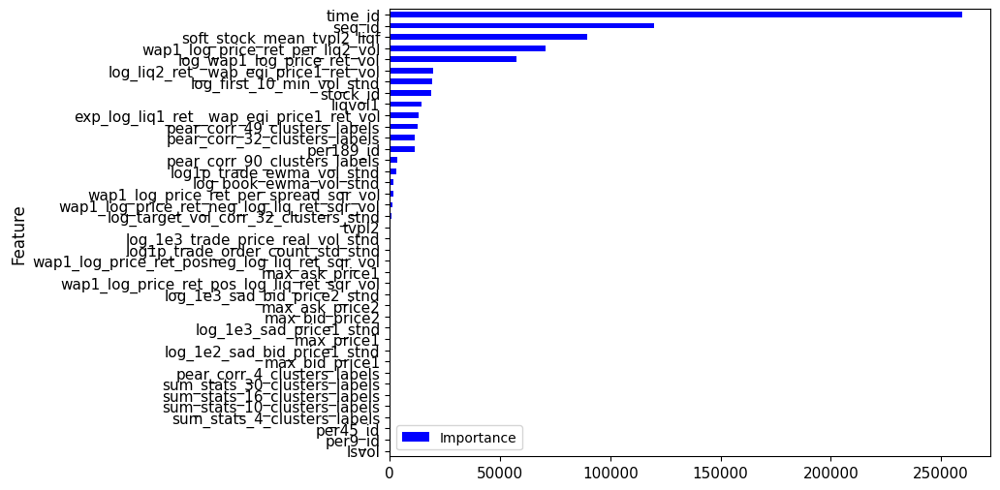

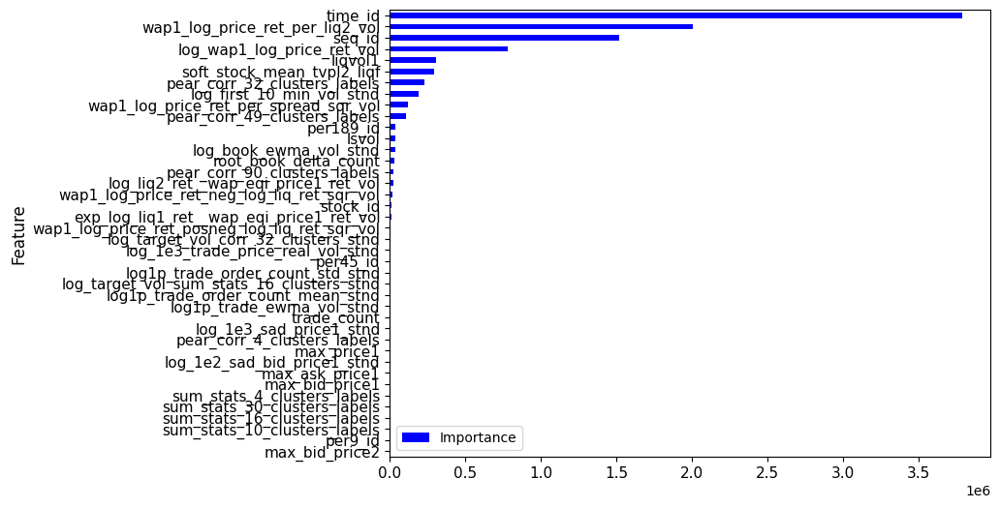

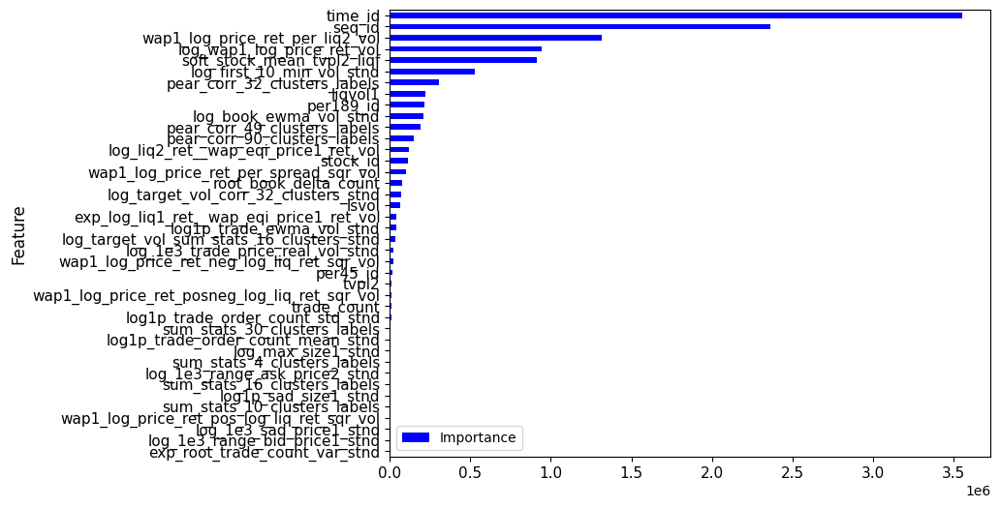

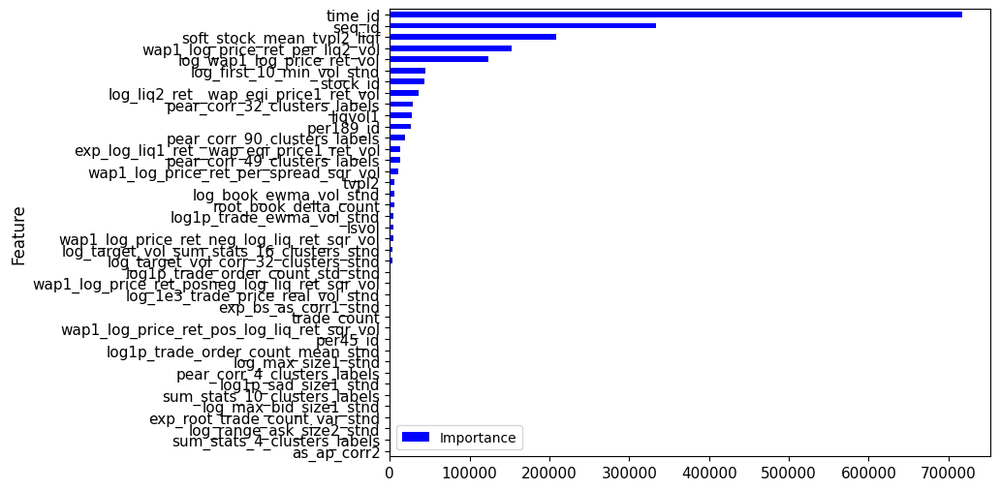

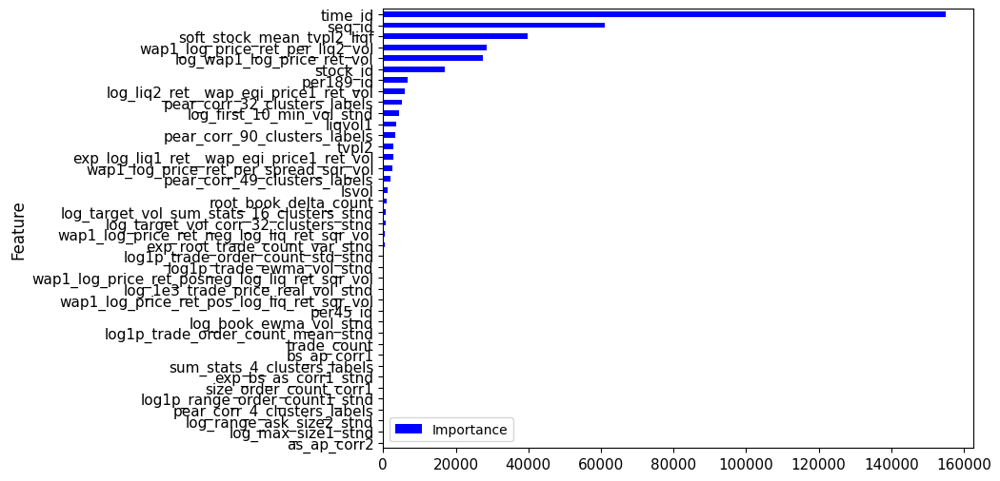

...

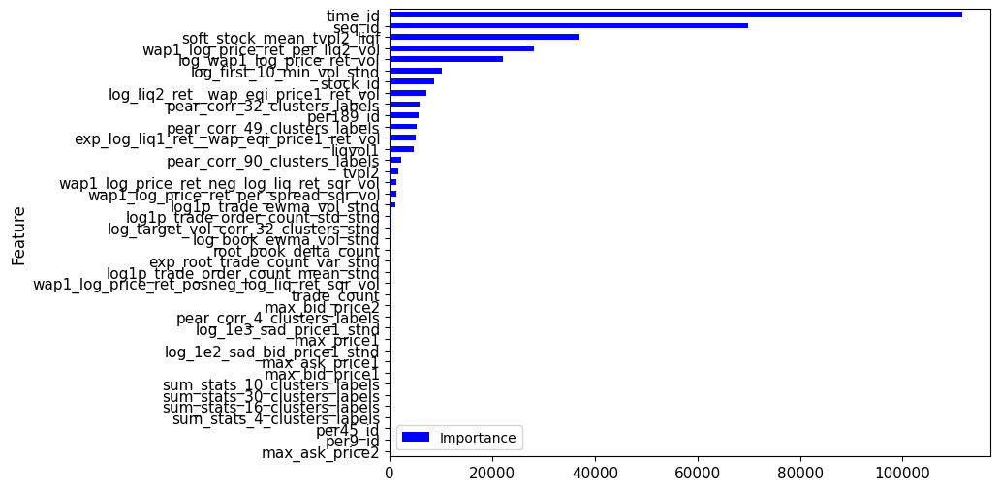

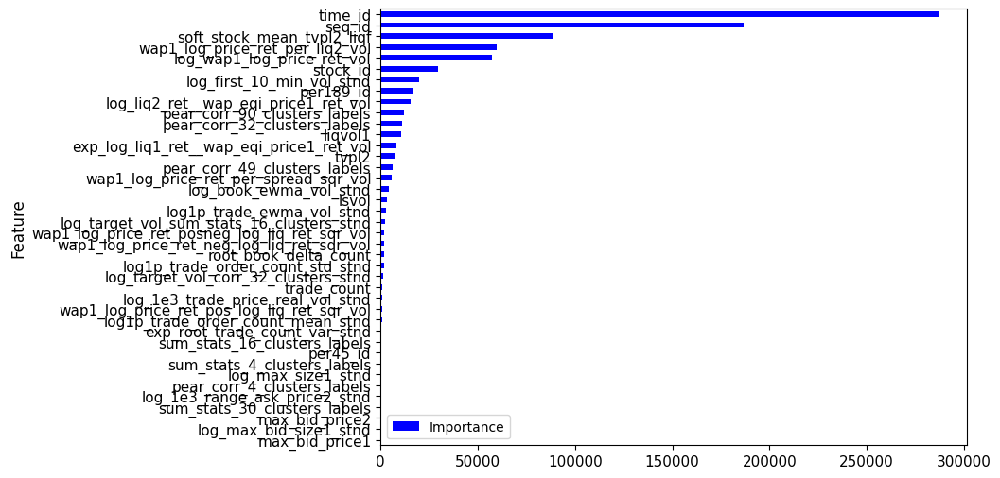

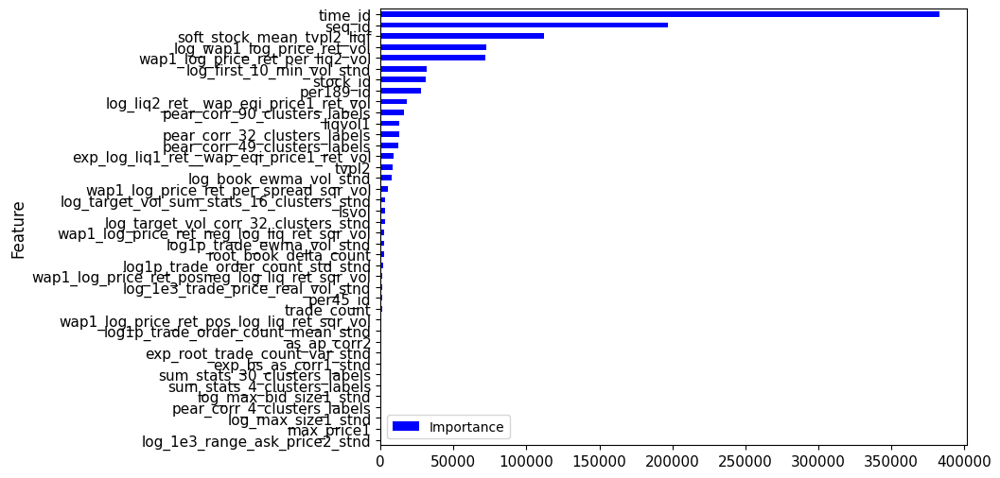

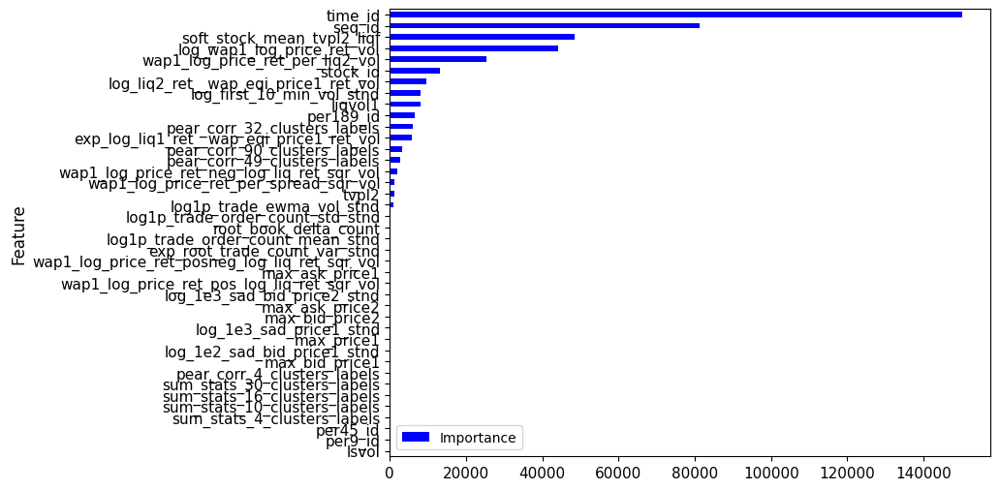

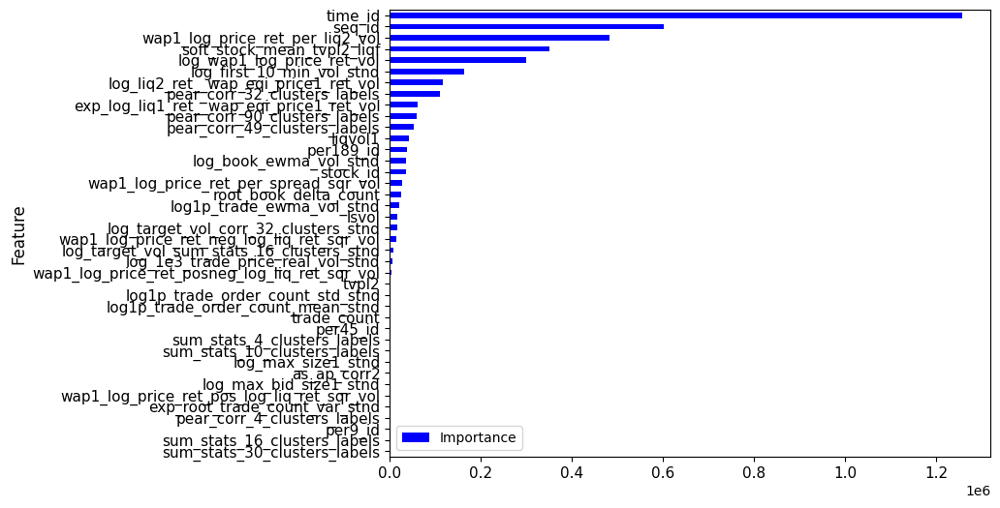

In [ ]:
if __name__ == "__main__":

    #optuna.logging.set_verbosity(optuna.logging.WARNING)

    study = optuna.create_study(direction="minimize")
    study.optimize(objective, timeout=12000, n_trials=50)

    pruned_trials = study.get_trials(deepcopy=False, states=[TrialState.PRUNED])
    complete_trials = study.get_trials(deepcopy=False, states=[TrialState.COMPLETE])

    print("Study statistics: ")
    print("  Number of finished trials: ", len(study.trials))
    print("  Number of pruned trials: ", len(pruned_trials))
    print("  Number of complete trials: ", len(complete_trials))

    print("Best trial:")
    trial = study.best_trial

    print("  Value: ", trial.value)

    print("  Params: ")
    for key, value in trial.params.items():
        print("    {}: {}".format(key, value))

    #print("Best hyperparameters:", study.best_params)

    fig = optuna.visualization.plot_parallel_coordinate(study)
    fig.show()

    fig = optuna.visualization.plot_optimization_history(study)
    fig.show()

    fig = optuna.visualization.plot_slice(study)
    fig.show()

    fig = optuna.visualization.plot_param_importances(study)
    fig.show()



Final model
corr(test_pred/v1ts, y_test/v1ts) 0.4235733836246077
log(corr( )) 0.47091306807871663
corr(test_pred, y_test) 0.8911730596097216
log(corr( )) 0.9100131238676704
mean rmspe test score:  0.24013751081101894
####################################### PREDICTION #################################################


##################################################################################################


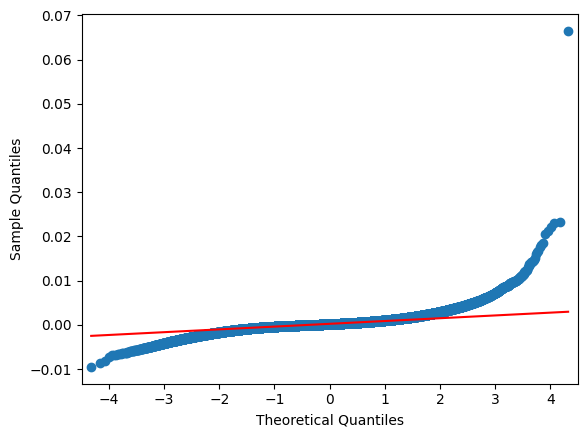

In [ ]:
hand_picked_df = df2 #df2[hand_picked_cols]

num_rounds = 500
seed1 = 11
early_stopping_rounds = 50

# best_params = {
#         'learning_rate': study.best_params['learning_rate'],
#         'lambda_l1': study.best_params['lambda_l1'],
#         'lambda_l2': study.best_params['lambda_l2'],
#         'num_leaves': study.best_params['num_leaves'],
#         'min_sum_hessian_in_leaf':  study.best_params['min_sum_hessian_in_leaf'],
#         'feature_fraction': study.best_params['feature_fraction'],
#         'feature_fraction_bynode': study.best_params['feature_fraction_bynode'],
#         'bagging_fraction': study.best_params['bagging_fraction'],
#         'bagging_freq': study.best_params['bagging_freq'],
#         'min_data_in_leaf': study.best_params['min_data_in_leaf'],
#         'max_depth': study.best_params['max_depth'],
#         'objective': 'regression',
#         'metric': 'None',
#         'device':'cpu', #gpu
#         'seed': seed1,
#         'feature_fraction_seed': seed1,
#         'bagging_seed': seed1,
#         'drop_seed': seed1,
#         'data_random_seed': seed1,
#         'boosting': 'gbdt',
#         'verbosity': -1,
#         'n_jobs':-1,
# }

best_params = {
        'learning_rate':  0.04903565039483271,
        'lambda_l1': 1,
        'lambda_l2': 1,
        'num_leaves': 16,
        'min_sum_hessian_in_leaf': 3,
        'feature_fraction': 0.6,
        'feature_fraction_bynode': 0.6,
        'bagging_fraction': 0.8999999999,
        'bagging_freq': 50,
        'min_data_in_leaf': 75,
        'max_depth': 5,
        'objective': 'regression',
        'metric': 'None',
        'device':'cpu', #gpu
        'seed': seed1,
        'feature_fraction_seed': seed1,
        'bagging_seed': seed1,
        'drop_seed': seed1,
        'data_random_seed': seed1,
        'boosting': 'gbdt',
        'verbosity': -1,
        'n_jobs':-1,
}



t_v_t = train_validate_n_test(hand_picked_df)
final_reg,test_pred, y_test,train_pred,y_train = t_v_t.make_predictions(best_params,num_rounds)
t_v_t.evaluate_predictions(final_reg,test_pred, y_test,train_pred,y_train)

## save the best model with timestamp for future use.
timestamp = datetime.now().strftime('%Y%m%d_%H%M%S')
filename = f'lgbm_gbdt_{timestamp}.pkl'
os.chdir('/content/drive/MyDrive/optiver_real_vol/liquidity_features/lgbm_gbdt_model_registry')
with open(filename, 'wb') as file:
    pickle.dump(lgb_model, file)
print(f'Model saved to: {filename}')
os.chdir('/content/drive/MyDrive/optiver_real_vol/liquidity_features')